# 1. Сбор и очистка данных

In [1]:
from utils.support import *
from datetime import datetime
import seaborn as sns
from ydata_profiling import ProfileReport

from sklearn import linear_model, ensemble, feature_selection, \
    metrics, model_selection, preprocessing, decomposition
from scipy import stats    
import lightgbm as lgbm

import warnings
warnings.filterwarnings('ignore')

In [2]:
# уровень значимости
alpha = 0.05

In [3]:
data = pd.read_csv('data/bank_data.csv', sep=',')
data

,fraud_bool,income,name_email_similarity,prev_address_months_count,current_address_months_count,customer_age,days_since_request,intended_balcon_amount,payment_type,zip_count_4w,...,has_other_cards,proposed_credit_limit,foreign_request,source,session_length_in_minutes,device_os,keep_alive_session,device_distinct_emails_8w,device_fraud_count,month
0,0,0.9,0.990415,11,4,40,0.014640,-0.897718,AC,1853,...,0,200.0,0,INTERNET,6.150317,windows,0,1,0,0
1,0,0.4,0.781728,-1,151,30,0.013269,11.501507,AA,5447,...,0,1500.0,0,INTERNET,4.521952,windows,1,1,0,0
2,0,0.7,0.274290,-1,92,20,0.010669,23.943928,AA,2312,...,0,200.0,0,INTERNET,8.361707,other,1,1,0,0
3,0,0.9,0.722684,-1,55,20,0.021849,48.202774,AA,2413,...,0,1500.0,0,INTERNET,7.339743,other,0,1,0,0
4,0,0.9,0.121661,-1,51,20,0.021491,-1.602116,AB,1227,...,0,1500.0,0,INTERNET,4.338063,other,0,1,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
999995,0,0.9,0.173671,-1,110,30,0.004057,-1.451974,AB,979,...,0,200.0,0,INTERNET,5.740367,other,1,1,0,7
999996,0,0.9,0.566285,-1,29,50,0.014215,-0.672890,AB,1190,...,0,200.0,0,INTERNET,26.319296,linux,0,1,0,7
999997,0,0.6,0.807476,-1,164,30,0.040160,46.129201,AA,1571,...,0,1000.0,0,INTERNET,1.614444,linux,1,1,0,7
999998,0,0.8,0.151376,87,12,30,0.016871,-1.212084,AC,1435,...,0,200.0,0,INTERNET,3.682591,linux,0,1,0,7


In [4]:
data.shape

(1000000, 32)

In [5]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1000000 entries, 0 to 999999
Data columns (total 32 columns):
 #   Column                            Non-Null Count    Dtype  
---  ------                            --------------    -----  
 0   fraud_bool                        1000000 non-null  int64  
 1   income                            1000000 non-null  float64
 2   name_email_similarity             1000000 non-null  float64
 3   prev_address_months_count         1000000 non-null  int64  
 4   current_address_months_count      1000000 non-null  int64  
 5   customer_age                      1000000 non-null  int64  
 6   days_since_request                1000000 non-null  float64
 7   intended_balcon_amount            1000000 non-null  float64
 8   payment_type                      1000000 non-null  object 
 9   zip_count_4w                      1000000 non-null  int64  
 10  velocity_6h                       1000000 non-null  float64
 11  velocity_24h                      1000

In [6]:
data.duplicated(subset=data.columns).sum()

0

Итак, в данных не представлено явных пропусков или дубликатов. Однако, как написано в описании к датасету, в некоторых признаках есть неявные пропуски, а именно в:
<br>
* prev_address_months_count
* current_address_months_count
* bank_months_count
* session_length_in_minutes

In [7]:
na_list = ['prev_address_months_count',
'current_address_months_count',
'bank_months_count',
'session_length_in_minutes']
# для каждой фичи с пропусками посчитаем топ-3 встречающихся значения
for i in na_list:
    print(data[i].value_counts(ascending=False, normalize=True).iloc[:3]*100, '\n')

prev_address_months_count
-1     70.4367
 11     1.1949
 28     1.0637
Name: proportion, dtype: float64 

current_address_months_count
7    1.6874
6    1.6666
8    1.6658
Name: proportion, dtype: float64 

bank_months_count
-1     25.4905
 1     19.7603
 28     8.0075
Name: proportion, dtype: float64 

session_length_in_minutes
-1.000000    0.1842
 5.009762    0.0003
 4.515570    0.0003
Name: proportion, dtype: float64 



Что стало ясно из анализа пропусков:
1. Признак 'prev_address_months_count' имеет 70 % пропусков - считаю, что данный признак нельзя использовать;
2. В признаке 'bank_months_count' 25 % пропусков - значительное количество, но важную информацию можно извлечь;
3. В оставшихся 'current_address_months_count' и 'session_length_in_minutes' незначительное кол-во пропусков.

Решил также проверить категориальные признаки на наличие пропусков (возможно, есть какое-нибудь значение типо NA):

In [8]:
cat_list = [x for x in data.columns if data[x].dtype == 'object']
# source имеет только два значения - значит, можно сделать бинарным
# преобразуем категориальный source
data['source'] = data['source'].apply(lambda x: 1 if x=='INTERNET' else 0)
# удаляем source из категориальных
cat_list.remove('source')
cat_list

['payment_type', 'employment_status', 'housing_status', 'device_os']

In [9]:
for i in cat_list:
    print(data[i].value_counts(ascending=False, normalize=100), '\n')

payment_type
AB    0.364724
AA    0.260651
AC    0.253419
AD    0.120964
AE    0.000242
Name: proportion, dtype: float64 

employment_status
CA    0.742492
CB    0.137901
CF    0.043573
CD    0.026232
CC    0.025806
CE    0.023562
CG    0.000434
Name: proportion, dtype: float64 

housing_status
BC    0.380697
BB    0.253335
BE    0.180269
BA    0.157615
BD    0.026203
BF    0.001615
BG    0.000266
Name: proportion, dtype: float64 

device_os
other        0.352678
linux        0.329750
windows      0.255543
macintosh    0.054974
x11          0.007055
Name: proportion, dtype: float64 



Каких-то обозначений пропусков не нашлось. Тогда, возвращаясь к количественным признакам с пропусками, заполним пропуски в 'current_address_months_count' и 'session_length_in_minutes' медианной, 'prev_address_months_count' - удалим:

In [10]:
# удаляем признак с большим процентом пропусков
data.drop('prev_address_months_count', axis=1, inplace=True)
# заполняем пропуски медианой
data['current_address_months_count'].replace(-1, data['current_address_months_count'].median(), inplace=True)
data['session_length_in_minutes'].replace(-1, data['session_length_in_minutes'].median(), inplace=True)

Разберемся, как заполнить пропуски в 'bank_months_count': вторым по популярности значением, медианным или предсказанным моделью?

<Axes: >

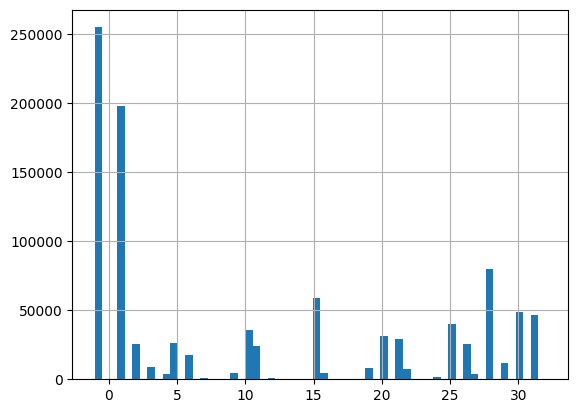

In [14]:
# график распределения 'bank_months_count'
data['bank_months_count'].hist(bins=60)

Гистограмма имеет пик в значении 1, в остальном он довольно хаотичен. Вывод: используем модель. Для этого создадим тренировочную и тестовую выборку, причем из тренировочной нужно исключить целевую переменную (чтобы не произошло утечки данных). Вместе с ней удалим и признак device_fraud_count, т.к. есть подозрение, что в нем также утечка данных, а также категориальные переменные.

In [ ]:
# разделяем данные
X_train, X_test = data[data['bank_months_count'] != -1], data[data['bank_months_count'] == -1]
y_train, y_test = X_train['bank_months_count'], X_test['bank_months_count']

X_train.drop('bank_months_count', axis=1, inplace=True)
X_test.drop('bank_months_count', axis=1, inplace=True)

# удаляем непригодные для данной модели признаки
drop_list = ['fraud_bool', 'device_fraud_count'] + cat_list
X_train.drop(drop_list, axis=1, inplace=True)
X_test.drop(drop_list, axis=1, inplace=True)

# строим и обучаем модель
rnd_forest_bank_months = ensemble.RandomForestRegressor(n_estimators=40, 
                                                        criterion='friedman_mse', 
                                                        max_depth=8,
                                                        min_samples_split=25000
                                                        )

rnd_forest_bank_months.fit(X_train, y_train)

pred = rnd_forest_bank_months.predict(X_test)
# считаем метрику rmse и выводим ее
score = metrics.root_mean_squared_error(y_test, pred)
print('rmse: ', score)
# удаляем ненужные датафреймы для оптимизации работы
del(X_test, X_train, y_test, y_train)

In [ ]:
# запись полученных значений для заполнения пропусков
with open('data/bank_month_pred.csv', 'wb+') as f:
    pickle.dump(pred, file=f)
    f.close()
# логирование
with open('logs/bank_month.txt', 'a') as file:
    timestamp = datetime.now().strftime('%Y-%m-%d-%H')
    file.write(f'{timestamp}: rmse - {score}\n')

In [ ]:
# загрузка полученных значений для заполнения пропусков
with open('data/bank_month_pred.csv', 'rb+') as f:
    pred = pickle.load(f)
    f.close()

In [ ]:
# подстановка пропущенных значений
data.loc[data['bank_months_count'] == -1, 'bank_months_count'] = pred

In [ ]:
data['bank_months_count'].value_counts(normalize=True, ascending=False)

bank_months_count
1.000000     0.197603
28.000000    0.080075
15.000000    0.058703
30.000000    0.049069
31.000000    0.046721
               ...   
14.196971    0.000001
18.009709    0.000001
14.032658    0.000001
14.787054    0.000001
12.028469    0.000001
Name: proportion, Length: 42719, dtype: float64

Итак, с изначальными данными поработали, теперь переходим к их анализу!

# 2. Разведывательный анализ данных (EDA)

Сперва вопспользуемся общими методами:

In [ ]:
# статистические описание количественных признаков
data.describe()

,fraud_bool,income,name_email_similarity,current_address_months_count,customer_age,days_since_request,intended_balcon_amount,zip_count_4w,velocity_6h,velocity_24h,...,bank_months_count,has_other_cards,proposed_credit_limit,foreign_request,source,session_length_in_minutes,keep_alive_session,device_distinct_emails_8w,device_fraud_count,month
count,1000000.000000,1000000.000000,1.000000e+06,1000000.000000,1000000.000000,1.000000e+06,1000000.000000,1000000.000000,1000000.000000,1000000.000000,...,1000000.000000,1000000.000000,1000000.000000,1000000.000000,1000000.000000,1000000.000000,1000000.000000,1000000.000000,1000000.0,1000000.000000
mean,0.011029,0.560867,4.946516e-01,83.811934,31.974200,1.051720e+00,8.715090,1574.468789,5661.914760,4767.082829,...,14.729853,0.218157,507.156910,0.025010,0.993214,7.475909,0.579841,1.016889,0.0,3.288668
std,0.104438,0.290389,2.888474e-01,86.303026,10.897167,5.462110e+00,20.210541,1003.700453,3010.869604,1481.613486,...,10.005275,0.412995,481.460578,0.156155,0.082097,7.941014,0.493584,0.175465,0.0,2.209990
min,0.000000,0.100000,5.024707e-08,0.000000,10.000000,1.373749e-08,-15.739893,1.000000,-174.109691,1322.325176,...,1.000000,0.000000,190.000000,0.000000,0.000000,0.000047,0.000000,-1.000000,0.0,0.000000
25%,0.000000,0.300000,2.268462e-01,19.000000,20.000000,7.150757e-03,-1.180401,893.000000,3431.170414,3587.024902,...,5.000000,0.000000,200.000000,0.000000,1.000000,3.110212,0.000000,1.000000,0.0,1.000000
50%,0.000000,0.600000,4.922199e-01,50.000000,30.000000,1.510390e-02,-0.828224,1270.000000,5299.991908,4745.547722,...,14.896734,0.000000,200.000000,0.000000,1.000000,5.081925,1.000000,1.000000,0.0,3.000000
75%,0.000000,0.800000,7.558383e-01,124.000000,40.000000,2.618513e-02,6.215877,1952.000000,7692.312342,5753.146673,...,25.000000,0.000000,500.000000,0.000000,1.000000,8.758878,1.000000,1.000000,0.0,5.000000
max,1.000000,0.900000,1.000000e+00,429.000000,90.000000,7.663502e+01,113.120051,6678.000000,16817.838935,9539.356530,...,32.000000,1.000000,2100.000000,1.000000,1.000000,85.567848,1.000000,2.000000,0.0,7.000000


In [ ]:
# статистические описание категориальных признаков
data.describe(include='object')

,payment_type,employment_status,housing_status,device_os
count,1000000,1000000,1000000,1000000
unique,5,7,7,5
top,AB,CA,BC,other
freq,364724,742492,380697,352678


In [ ]:
ProfileReport(data)

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

* fraud_bool - целевая переменная - несбалансированная, что очевидно и естественно для такой задачи, т.к. большинство * операций - немошеннические;
* credit_risk_score - нормальное распределение;
* customer_age - похоже на нормальное; 
* velocity_24h - похоже на нормальное;
* current_address_months_count - лог нормальное;
* date_of_birth_distinct_emails_4w - нормальное со сдвигом влево, возможны выбросы;
* session_length_in_minutes - лог номральное;
* device_fraud_count - везде 0, т.е. признак абсолютно неинформативен;
* bank_moths_count - корелляция 1 с months_count;

<Axes: >

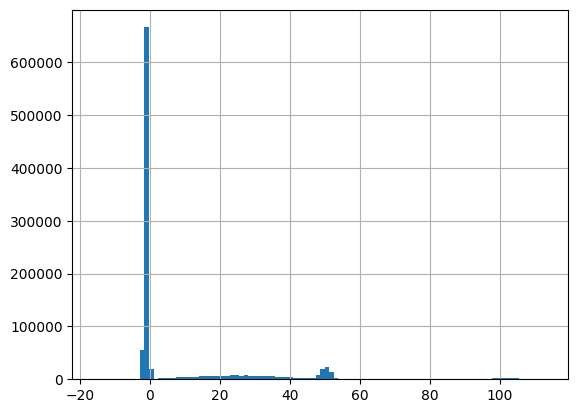

In [ ]:
data['intended_balcon_amount'].hist(bins=100)

Заметил на данном этапе что у device_distinct_emails_8w есть значения -1, т.е. пропущенные. Их всего 318, поэтому заполнил значения медианой (которая также является самым популярным значением):

In [ ]:
data['device_distinct_emails_8w'].replace(-1, 1, inplace=True)

In [ ]:
# избавляемся от неинформативного признака
data.drop('device_fraud_count', axis=1, inplace=True)

Наконец, **очень важный этап**. Поскольку feedzai представили только один датасет (т.е. нет тестового), данные нужно разделить сейчас на тренировочную и тестовую выборки соответственно.
<p><i>P.S. скорее всего, буду использовать кросс-валидацию, поэтому валидационную выборку пока не создаю.</i></p>

In [ ]:
data, data_test = model_selection.train_test_split(data, test_size=0.25, stratify=data['fraud_bool'], random_state=rs)

In [ ]:
# чекпоинт
save_data(data_test, 'data/bank_data_test_init.csv')
save_data(data, 'data/bank_data_train_init.csv')

In [ ]:
0/0

ZeroDivisionError: division by zero

### Итак, переходим к "мозговому штурму".

1. Сперва оценим зависимость credit_risk_score от fraud_bool:

C:\Users\HUAWEI\AppData\Local\Temp\ipykernel_17888\3916703062.py:2: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(data, x='fraud_bool', y='credit_risk_score', palette="magma")


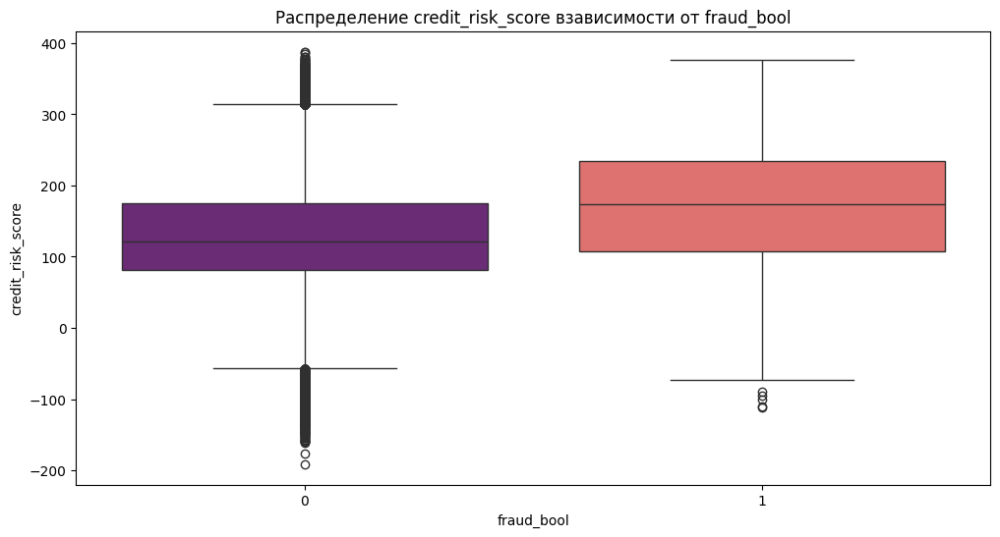

In [ ]:
plt.figure(figsize=(12, 6))
sns.boxplot(data, x='fraud_bool', y='credit_risk_score', palette="magma")
plt.title('Распределение credit_risk_score взависимости от fraud_bool');

Как видим, распределения разные, а именно в случае мошенничества кредитный риск выше. Однако так же много и "выбросов" у fraud_bool=0 : т.е. credit_risk_score высокий, а транзакция по факту не мошенническая. По факту выбросами это считать нельзя, это просто ошибка внутреннего рейтинга. Признак не идеален, однако все еще информативен.

2. Это мы поработали с бинарным целевым и количественным признаком. Следующее, что хотелось бы исследовать - это зависимость между бинарными признаками, например, "продлевалась ли сессия на сайте", "поступал ли платеж из заграницы" и т.д.
<p> Для оценки зависимости двух бинарных признаков лучше всего использовать MCC (Matthews Correlation Coeffecient). </p>

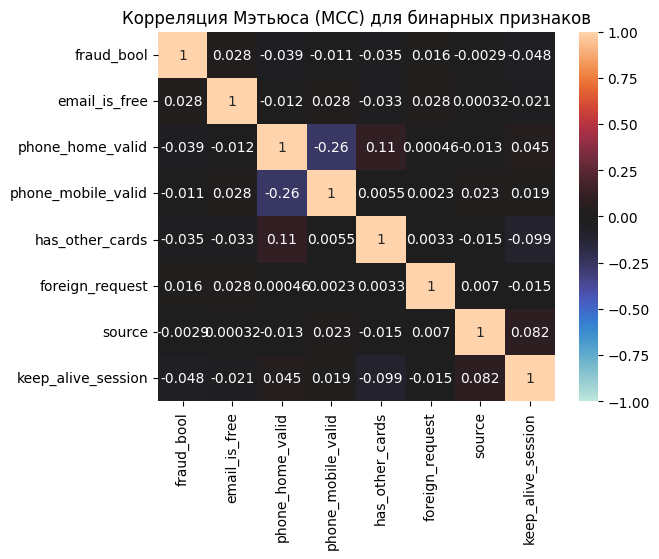

In [ ]:
# создадим список бинарных признаков
binary_features = ['fraud_bool', 'email_is_free', 'phone_home_valid', 'phone_mobile_valid', 'has_other_cards', \
    'foreign_request', 'source', 'keep_alive_session']
# строим тепловую карту
sns.heatmap(data[binary_features].corr(method=metrics.matthews_corrcoef), 
            cmap='icefire', center=0, vmin=-1,
            annot=True)
plt.title('Корреляция Мэтьюса (MCC) для бинарных признаков');

Как видим, между признаками очень слабые корреляции, близкие к нулю. Хотя бы какая-то связь есть между признакми phone_mobile_valid и phone_home_valid. Это натолкнуло на мысль, что эти признаки можно как-то объединить. Например, ввести новую фичу - только один номер телефона - валидный.

In [ ]:
data['only_one_valid'] = data['phone_home_valid'] ^ data['phone_mobile_valid']

corr_score = metrics.matthews_corrcoef(data['fraud_bool'], data['only_one_valid'])
print('MCC для нового признака: ', corr_score)

MCC для нового признака:  0.0319450022690451


Получили также невысокую корреляцию, однако признак все еще может быть полезен. Оставим его до этапа отбора признаков.

3. Теперь исследуем признаки, связанные со временем. Начнем с month. У него высокая корреляция (см. Profile Report) с velocity_4w.

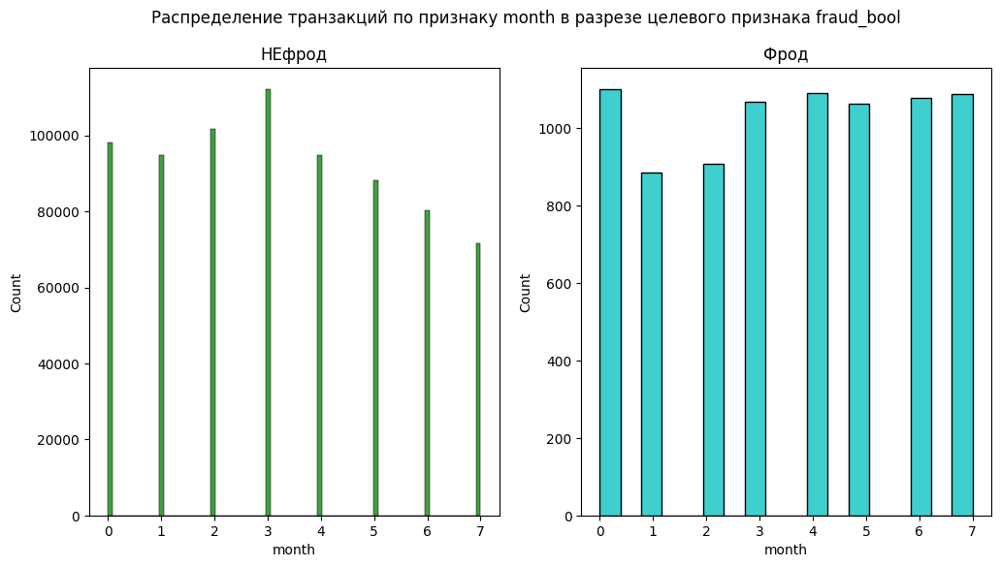

In [ ]:
def histplot_by_fraud(data, feature):
    fig, axes = plt.subplots(1, 2, figsize=(12, 6))
    sns.histplot(data[data['fraud_bool'] == 0], x=feature, color='g', ax=axes[0])
    sns.histplot(data[data['fraud_bool'] == 1], x=feature, color='c', ax=axes[1])
    axes[0].set_title('НЕфрод')
    axes[1].set_title('Фрод')
    plt.suptitle(f'Распределение транзакций по признаку {feature} в разрезе целевого признака fraud_bool');

histplot_by_fraud(data, 'month')

К сожалению, из-за анонимности данных, мы не можем проинтерпретировать числа month как порядковые числа месяца. Однако видна определенная значимость признака month: так, в период month = 0 было совершено самое большое кол-во мошеннических транзакций, в процентном соотношении - при month = 7.
<br><br> Есть идея - перекодировать признак month так, чтобы чем больше число - тем больший процент мошеннических атака было совершено в этот месяц.

In [ ]:
# функция, кодирующие порядковый признак по возрастанию процента мошеннических атак
def get_fraud_ranking(data, feature):
    fraud_percentage_month = data.groupby(feature)['fraud_bool'].mean()
    fraud_percentage_month = fraud_percentage_month.sort_values().rank().astype('uint8')-1
    return fraud_percentage_month.to_dict()

# получаем и применяем маппер для 'month'
month_rank_mapper = get_fraud_ranking(data, 'month')
data['month'] = data['month'].map(month_rank_mapper).fillna(0).astype('uint8')

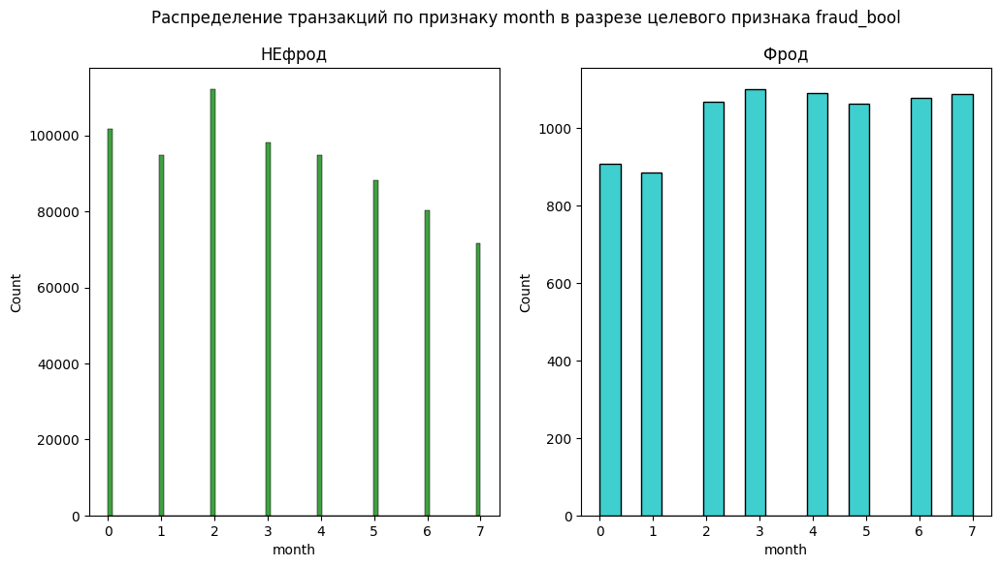

In [ ]:
histplot_by_fraud(data, 'month')

Отлично, теперь исследуем оставшиеся временные признаки.

In [ ]:
# создадим список временных фич
time_features_list = ['current_address_months_count', 'days_since_request', \
    'bank_months_count', 'session_length_in_minutes']

Из ProfileReport видим, что у всех них (кроме month) распределения имеют вытянутые "хвосты" вправо. Пока что оставим как есть, т.к. преобразования ухудшат интерпретацию данных.

4. Возраст, доход и кредитный лимит. Для начала найдем корреляцию возраста, дохода и fraud_bool попарно:

In [ ]:
# между ранговыми значениями лучше всего рассматривать корреляцию спирмана
rho, p_value = stats.spearmanr(data['income'], data['customer_age'])
print(f'rho: {round(rho, 2)}\np-value: {p_value}')

rho: 0.15
p-value: 0.0


Как видим, признаки статистически связаны (p-value меньше нашего заданного уровня значимости alpha=5%), но очень слабо (коэффицент корреляции всего 0.15).

In [ ]:
# найдем корреляцию между income и целевой переменной
r_income, p_value_income = stats.pointbiserialr(data['fraud_bool'], data['income'])

if p_value_income < alpha:
    print(f'p-value: {round(p_value_income, 2)}. Верна альтернативная гипотеза: целевая переменная зависит от дохода')
else:
    print(f'p-value: {round(p_value_income, 2)}. Верна нулевая гипотеза: целевая переменная НЕ зависит от дохода')

# найдем корреляцию между age и целевой переменной
r_age, p_value_age = stats.pointbiserialr(data['fraud_bool'], data['customer_age'])

if p_value_age < alpha:
    print(f'p-value: {round(p_value_age, 2)}. Верна альтернативная гипотеза: целевая переменная зависит от возраста')
else:
    print(f'p-value: {round(p_value_age, 2)}. Верна нулевая гипотеза: целевая переменная НЕ зависит от возраста')

p-value: 0.0. Верна альтернативная гипотеза: целевая переменная зависит от дохода
p-value: 0.0. Верна альтернативная гипотеза: целевая переменная зависит от возраста


In [ ]:
print(f'R-value доход: {round(r_income, 2)}')
print(f'R-value возраст: {round(r_age, 2)}')

R-value доход: 0.04
R-value возраст: 0.03


Наблюдаем крайне слабую связь.

А что же с кредитными лимитом?

In [ ]:
# найдем корреляцию между income и целевой переменной
_, p_value = stats.pointbiserialr(data['fraud_bool'], data['proposed_credit_limit'])

if p_value < alpha:
    print(f'p-value: {round(p_value, 2)}. Верна альтернативная гипотеза: целевая переменная зависит от дохода')
else:
    print(f'p-value: {round(p_value, 2)}. Верна нулевая гипотеза: целевая переменная НЕ зависит от дохода')

p-value: 0.0. Верна альтернативная гипотеза: целевая переменная зависит от дохода


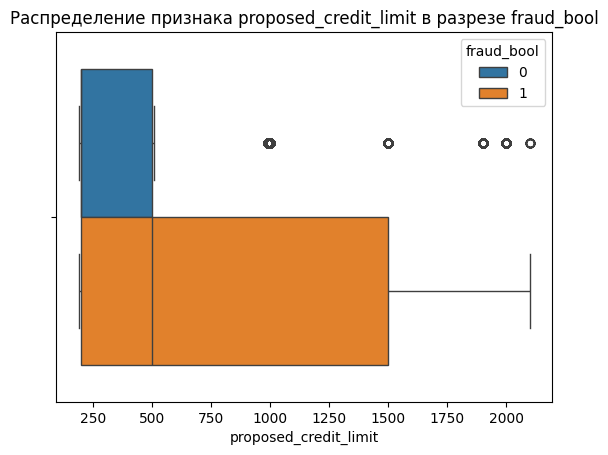

In [ ]:
sns.boxplot(data, x='proposed_credit_limit', hue='fraud_bool')
plt.title('Распределение признака proposed_credit_limit в разрезе fraud_bool');

In [ ]:
print('Медианное значение кредитного лимита обычных операций: ', \
    data[data['fraud_bool'] == 0]['proposed_credit_limit'].median())
print('Медианное значение кредитного лимита в случае мошеннических операций: ', \
    data[data['fraud_bool'] == 1]['proposed_credit_limit'].median())
print('Среднее значение кредитного лимита обычных операций: ', \
    data[data['fraud_bool'] == 0]['proposed_credit_limit'].mean())
print('Среднеезначение кредитного лимита в случае мошеннических операций: ', \
    data[data['fraud_bool'] == 1]['proposed_credit_limit'].mean())

Медианное значение кредитного лимита обычных операций:  200.0
Медианное значение кредитного лимита в случае мошеннических операций:  500.0
Среднее значение кредитного лимита обычных операций:  504.14056096035205
Среднеезначение кредитного лимита в случае мошеннических операций:  794.7630560928433


Полезная информация! Существенная разница распределений. Видим, что мошенники в среднем совершают операции на аккаунтах с более высоким кредитным лимитом. Однако у них и большой "размах" (как видим из ширины оранжевого прямоугольника).

5. device_os. Как программный инженер предполагаю, что большинство атак будут приходить с ОС Linux, как более свободного и настраиваемого (в том числе под неблагие цели) ОС.

Посмотрим на распределение device_os в разрезе fraud_bool:

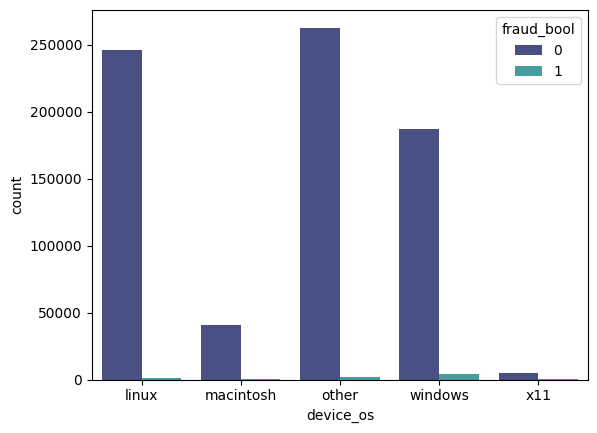

In [ ]:
# группируем данные
device_fraud = data.groupby(['device_os', 'fraud_bool']).count()
device_fraud = device_fraud[['income']].reset_index().rename({'income': 'count'}, axis=1)
# строим столбачтую диаграмму для каждого класса
sns.barplot(device_fraud, x='device_os', y='count', hue='fraud_bool', palette='mako');

Уже видно, что самый большой процент атак - с windows!

In [ ]:
data_os_fraud = data.groupby(by='device_os')['fraud_bool'].mean()
data_os_fraud.sort_values(ascending=False, inplace=True)
data_os_fraud

device_os
windows      0.023631
macintosh    0.016829
x11          0.011531
other        0.006243
linux        0.005390
Name: fraud_bool, dtype: float64

Оказалось, меньше всего атак приходит от пользователей Линукс! А большинство атак приходят с самых популярных WIndows и MacOS.

6. Ну и, наконец, нельзя пройти мимо скоростей транзакций. 

In [ ]:
# найдем корреляцию между скоростью транзакций за последние 6 часов и целевой переменной
r, p_value = stats.pointbiserialr(data['fraud_bool'], data['velocity_6h'])

if p_value < alpha:
    print(f'p-value: {round(p_value, 2)}. Верна альтернативная гипотеза: целевая переменная зависит от velocity_6h')
else:
    print(f'p-value: {round(p_value, 2)}. Верна нулевая гипотеза: целевая переменная НЕ зависит от velocity_6h')
print('r-value: ', round(r, 2))

p-value: 0.0. Верна альтернативная гипотеза: целевая переменная зависит от velocity_6h
r-value:  -0.02


In [ ]:
# найдем корреляцию между скоростью транзакций за последние 24 часа и целевой переменной
r, p_value = stats.pointbiserialr(data['fraud_bool'], data['velocity_6h'])

if p_value< alpha:
    print(f'p-value: {round(p_value, 2)}. Верна альтернативная гипотеза: целевая переменная зависит от velocity_24h')
else:
    print(f'p-value: {round(p_value, 2)}. Верна нулевая гипотеза: целевая переменная НЕ зависит от velocity_24h')
print('r-value: ', round(r, 2))

p-value: 0.0. Верна альтернативная гипотеза: целевая переменная зависит от velocity_24h
r-value:  -0.02


In [ ]:
# найдем корреляцию между скоростью транзакций за последние 4 недели и целевой переменной
r, p_value = stats.pointbiserialr(data['fraud_bool'], data['velocity_4w'])

if p_value< alpha:
    print(f'p-value: {round(p_value, 2)}. Верна альтернативная гипотеза: целевая переменная зависит от velocity_4w')
else:
    print(f'p-value: {round(p_value, 2)}. Верна нулевая гипотеза: целевая переменная НЕ зависит от velocity_4w')
print('r-value: ', round(r, 2))

p-value: 0.0. Верна альтернативная гипотеза: целевая переменная зависит от velocity_4w
r-value:  -0.01


Статистическая значимость есть, однако, очень слабая связь с целевой переменной. Скорее всего, более информативными будут признаки разности/отношений этих скоростей.

Небольшой вывод: хоть признаков и много, однако их корреляция с целевой переменной крайне низкая. Наиболее значимыми по итогу первичного анализа оказались credit_risk_score и proposed_credit_limit.
<p>Самое время перейти к проектированию признаков.</p>

---

# 3.1. Feature Engineering

1. Начнем со скоростей. Введем признаки разности и отношений между последовательными скоростями

<Axes: >

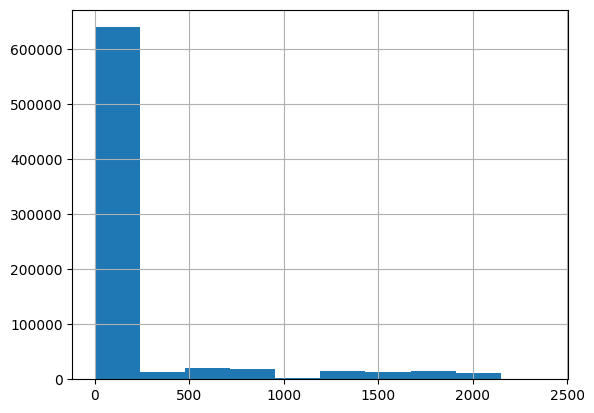

In [ ]:
data['bank_branch_count_8w'].hist()

In [ ]:
data['velocity_day_change'] = data['velocity_6h'] - data['velocity_24h']
data['velocity_day_month_change'] = data['velocity_6h'] - data['velocity_24h']
# не уверен относительно информативности данной фичи, но проверим
data['velocity_term_month_change'] = data['velocity_6h'] - data['velocity_4w']


data['velocity_day_ratio'] = data['velocity_6h']/data['velocity_24h']
data['velocity_day_month_ratio'] = data['velocity_6h']/data['velocity_24h']
# не уверен относительно информативности данной фичи, но проверим
data['velocity_term_month_ratio'] = data['velocity_6h']/data['velocity_4w']

In [ ]:
new_velocity_features = ['velocity_day_change', 'velocity_day_month_change', 'velocity_term_month_change', \
    'velocity_day_ratio', 'velocity_day_month_ratio', 'velocity_term_month_ratio']

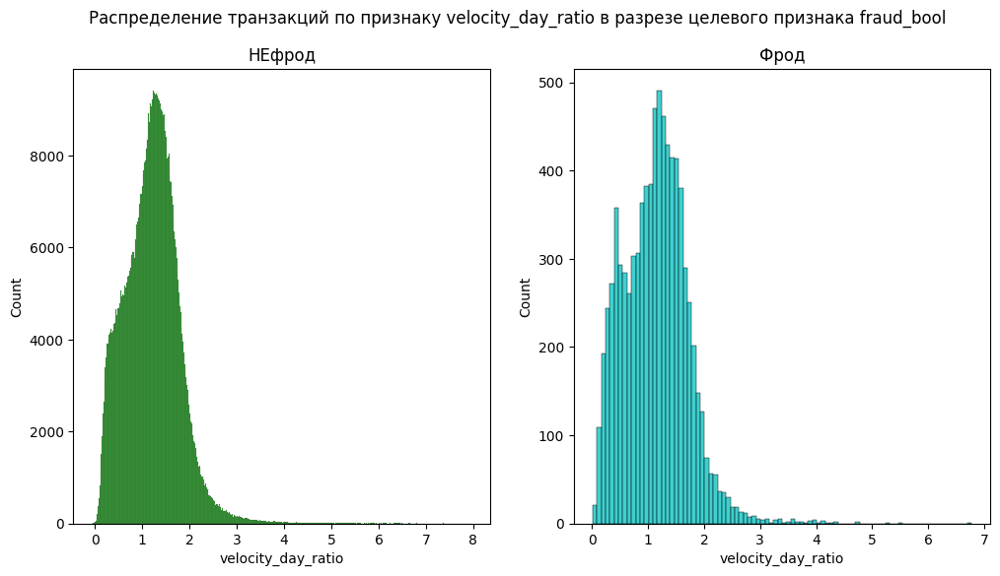

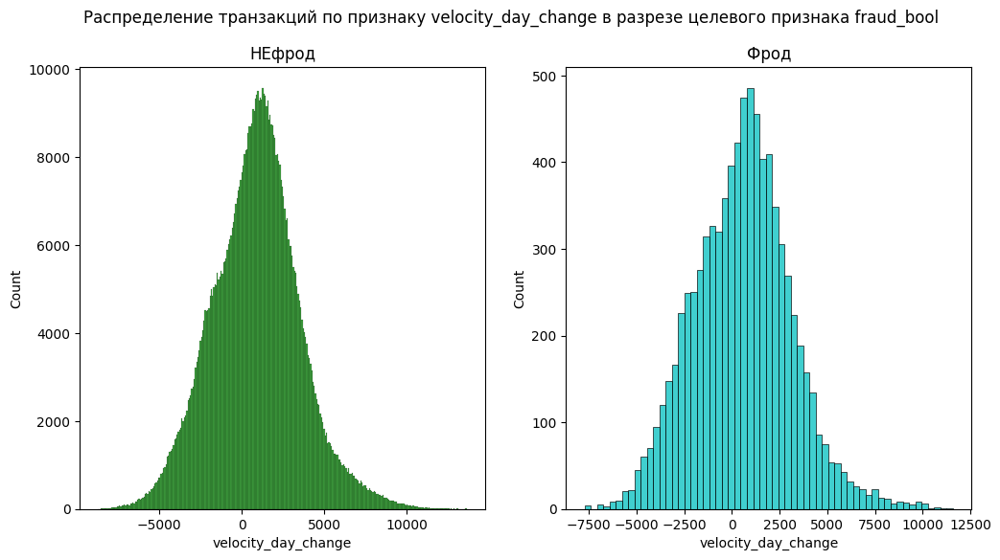

In [ ]:
histplot_by_fraud(data, 'velocity_day_ratio')
histplot_by_fraud(data, 'velocity_day_change')

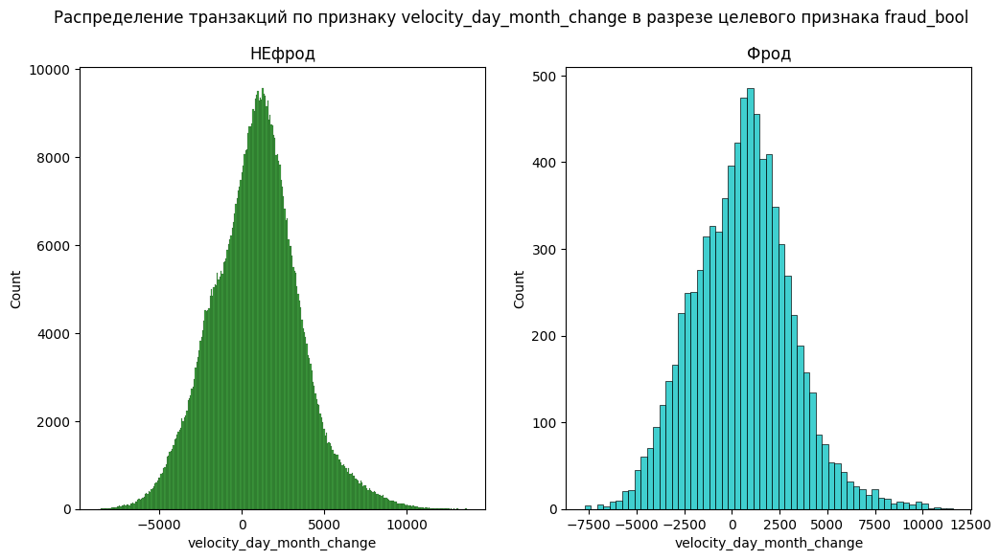

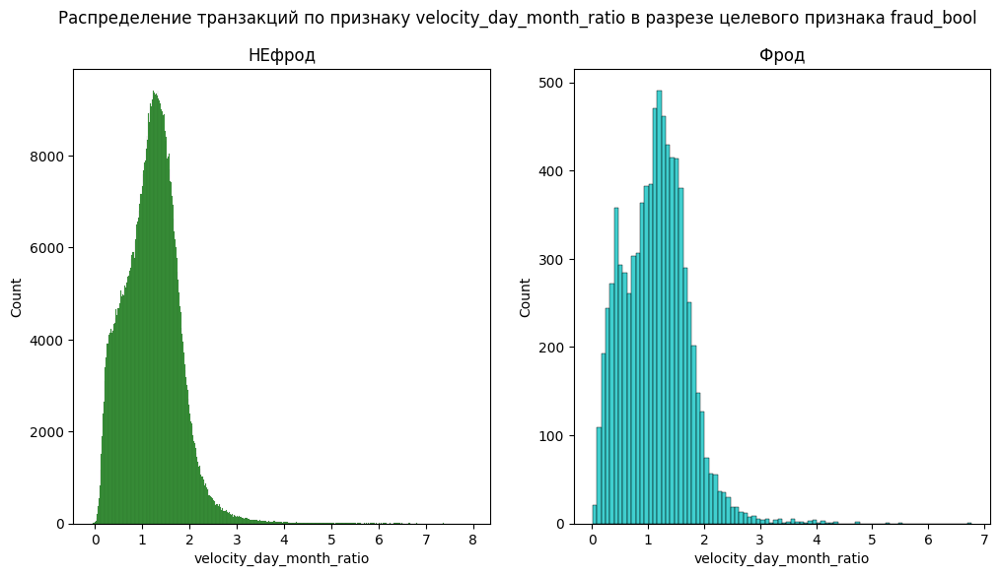

In [ ]:
histplot_by_fraud(data, 'velocity_day_month_change')
histplot_by_fraud(data, 'velocity_day_month_ratio')

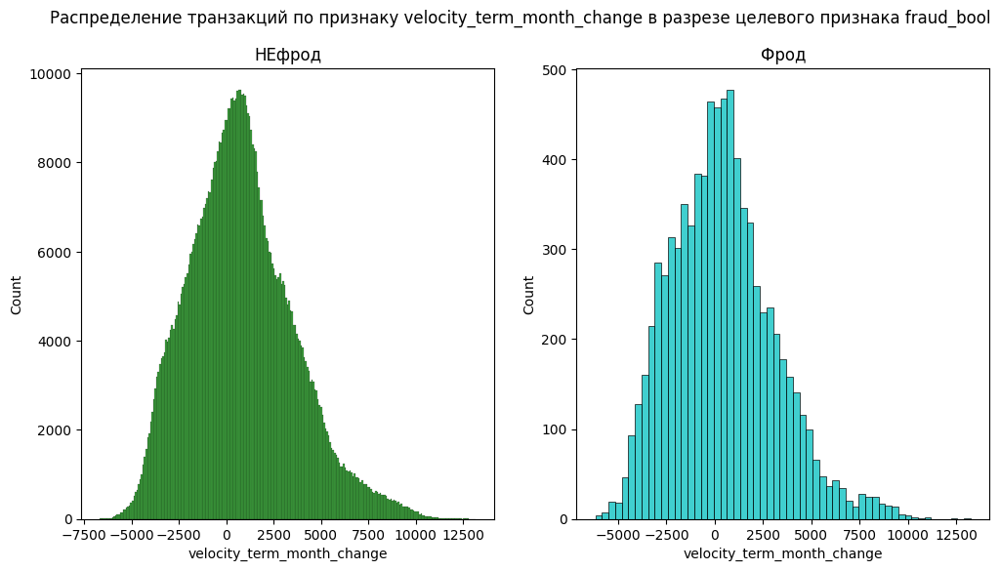

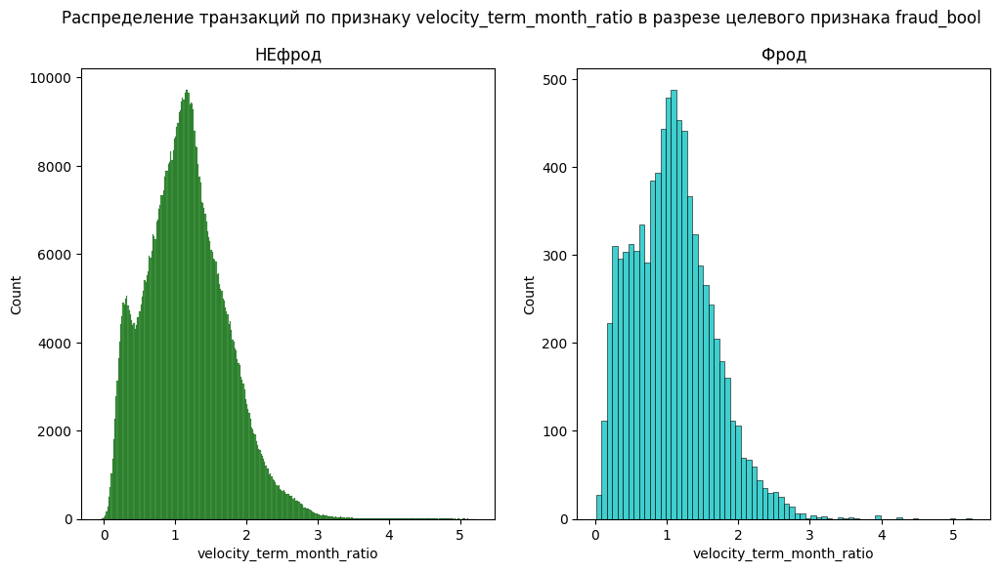

In [ ]:
histplot_by_fraud(data, 'velocity_term_month_change')
histplot_by_fraud(data, 'velocity_term_month_ratio')

Проверим следующую гипотезу: что полученные распредления изменения скоростей различаются для обычных и мошеннических операций. Для сравнения распределений отлично подойдет тест Колмогорова-Смирнова.

In [ ]:
# выделим два новых датафрейма: в одном чисто мошеннические операции
data_fraud = data[data['fraud_bool'] == 1]
# в другом - немошеннические
data_not_fraud = data[data['fraud_bool'] == 0]

In [ ]:
# функция, выполняющая тест Колмогорова-Смирнова
def ks_test(data_fraud, data_not_fraud, feature):
    _, p_value = stats.ks_2samp(data_fraud[feature], data_not_fraud[feature], alternative='greater')
    p_value = round(p_value, 10)
    print(f'{feature} p-value = ', p_value)
    if p_value <= alpha:
        print(f'Альтернативная гипотеза верна: распределение изменения скорости {feature} \
больше в мошеннических операциях')
    else:
        print(f'Нулевая гипотеза верна: распределение изменения {feature} скорости не больше, \
чем в мошеннических операциях')

for feature in new_velocity_features:
    ks_test(data_fraud, data_not_fraud, feature)

velocity_day_change p-value =  0.0
Альтернативная гипотеза верна: распределение изменения скорости velocity_day_change больше в мошеннических операциях
velocity_day_month_change p-value =  0.0
Альтернативная гипотеза верна: распределение изменения скорости velocity_day_month_change больше в мошеннических операциях
velocity_term_month_change p-value =  0.0
Альтернативная гипотеза верна: распределение изменения скорости velocity_term_month_change больше в мошеннических операциях
velocity_day_ratio p-value =  0.0
Альтернативная гипотеза верна: распределение изменения скорости velocity_day_ratio больше в мошеннических операциях
velocity_day_month_ratio p-value =  0.0
Альтернативная гипотеза верна: распределение изменения скорости velocity_day_month_ratio больше в мошеннических операциях
velocity_term_month_ratio p-value =  0.0
Альтернативная гипотеза верна: распределение изменения скорости velocity_term_month_ratio больше в мошеннических операциях


p-value значение очень мало, а значит, все наши новые признаки имеют разные распределения для мошеннических и немошеннических транзакций соответственно.

In [ ]:
data[new_velocity_features].corr()

,velocity_day_change,velocity_day_month_change,velocity_term_month_change,velocity_day_ratio,velocity_day_month_ratio,velocity_term_month_ratio
velocity_day_change,1.000000,1.000000,0.894775,0.938840,0.938840,0.871640
velocity_day_month_change,1.000000,1.000000,0.894775,0.938840,0.938840,0.871640
velocity_term_month_change,0.894775,0.894775,1.000000,0.809884,0.809884,0.981352
velocity_day_ratio,0.938840,0.938840,0.809884,1.000000,1.000000,0.817475
velocity_day_month_ratio,0.938840,0.938840,0.809884,1.000000,1.000000,0.817475
velocity_term_month_ratio,0.871640,0.871640,0.981352,0.817475,0.817475,1.000000


Вижу высокую корреляцию между ними, скорее всего, нужно будет применять PCA. Оставим это до финального этапа - Отбора признаков.

In [ ]:
save_data(data, 'data/bank_data_train.csv')

In [ ]:
data = open_data('data/bank_data_train.csv')

In [ ]:
# data

---

2. Категориальные признаки.

In [ ]:
data[cat_list]

,payment_type,employment_status,housing_status,device_os
634102,AB,CA,BA,other
173005,AA,CB,BB,other
40774,AC,CF,BB,other
606711,AC,CA,BA,windows
429877,AC,CA,BC,other
...,...,...,...,...
187743,AB,CD,BB,linux
126160,AC,CA,BA,linux
941678,AA,CA,BC,linux
903476,AB,CA,BB,other


Из Profile Report категорий в каждом признаке не больше 8. То есть можно было бы применить One-Hot Encoding, но интересно было бы посмотреть на информативность комбинаций.

Ситуация осложнена также анонимностью данных: не представлены интерпретации данных признаков, т.е. предположения, как и категории данных признаков, абстрактны. 

In [ ]:
data['employment_status'].value_counts()

employment_status
CA    557158
CB    103226
CF     32604
CD     19787
CC     19261
CE     17637
CG       327
Name: count, dtype: int64

In [ ]:
data['housing_status'].value_counts()

housing_status
BC    285675
BB    189632
BE    135427
BA    118210
BD     19666
BF      1191
BG       199
Name: count, dtype: int64

In [ ]:
# список всех возможных значений 'employment_status'
employment_list = list(data['employment_status'].unique())
# список всех возможных значений 'housing_status'
housing_list = list(data['housing_status'].unique())
# создаем пустой DataFrame
employment_housing_frame = pd.DataFrame(np.zeros((data.shape[0])), index=data.index)
# создаем флаги-пары признаков
for e_status in employment_list:
    for h_status in housing_list:
        new_status_column = ((data['employment_status']==e_status) & (data['housing_status']==h_status)).astype('uint8')
        employment_housing_frame[f'{e_status}_{h_status}'] = new_status_column
# удаляем первый нулевой столбец
employment_housing_frame.drop(0, axis=1, inplace=True)

In [ ]:
# высчитываем взаимную информативность созданных пар признаков
mutual_info = feature_selection.mutual_info_classif(employment_housing_frame, data['fraud_bool'], discrete_features=True)
# преобразуем в список, сортируем и выводим топ-5 значений
mutual_info_series = pd.Series(mutual_info, index=employment_housing_frame.columns)
mutual_info_series.sort_values(ascending=False, inplace=True)
top_5 = mutual_info_series.head(5)
top_5

CA_BA    0.003721
CA_BE    0.000370
CA_BC    0.000190
CF_BB    0.000175
CA_BB    0.000145
dtype: float64

Посмотрим на рабочий статус и статус проживания в отдельности:

In [ ]:
# создаем отдельные датафреймы для employment_status и housing_status
raw_employment = pd.get_dummies(data[['employment_status']]).astype('uint8')
raw_housing = pd.get_dummies(data[['housing_status']]).astype('uint8')
# считаем взаимную информативность
employment_mutual_info = feature_selection.mutual_info_classif(raw_employment, data['fraud_bool'], \
    discrete_features=True)
housing_mutual_info = feature_selection.mutual_info_classif(raw_housing, data['fraud_bool'], \
    discrete_features=True)
# преобразуем в Series и выводим топ-2 по информативности
mutual_info_series = pd.Series(employment_mutual_info, index=raw_employment.columns)
mutual_info_series.sort_values(ascending=False, inplace=True)
top_2_employment = mutual_info_series.head(2)

mutual_info_series = pd.Series(housing_mutual_info, index=raw_housing.columns)
mutual_info_series.sort_values(ascending=False, inplace=True)
top_2_housing = mutual_info_series.sort_values(ascending=False).head(2)

print('Взаимная информативность целевой переменной и employment_status:', employment_mutual_info)
print('Взаимная информативность целевой переменной и housing_status:', housing_mutual_info)
print(top_2_employment)
print(top_2_housing)

Взаимная информативность целевой переменной и employment_status: [4.07282501e-04 1.31379579e-04 1.47283405e-05 6.42264462e-05
 1.24566522e-04 2.65618900e-04 3.24120123e-07]
Взаимная информативность целевой переменной и housing_status: [3.95008707e-03 4.72357422e-04 4.35841605e-04 1.89173560e-06
 5.60362352e-04 3.27876216e-06 1.78719073e-07]
employment_status_CA    0.000407
employment_status_CF    0.000266
dtype: float64
housing_status_BA    0.00395
housing_status_BE    0.00056
dtype: float64


Итак, как видим, признаки показывают маленькую информативность, причем как в парах, так и по отдельности. Поэтому из всех многочисленных новых пар лучше выбрать топ 5-8 по информативности и добавить в исходный датафрейм. Напишем всопомгательную функцию, т.к. хочется еще проверить попарные ифнормативности признаков вместе в payment_type:  

In [ ]:
# функция, возвращающая топ-k значений по информативности двух признаков с целевой переменной
def get_top_k_cat_features(X, y, feature_1, feature_2, k=5):
    if k <= 0 or type(k) is not int:
        raise ValueError('Value fo k must be positive integer!')
    # сначала рассматриваем признаки в отдельности 
    # создаем отдельные датафреймы
    feature_1_frame = pd.get_dummies(X[[feature_1]]).astype('uint8')
    feature_2_frame = pd.get_dummies(X[[feature_2]]).astype('uint8')
    # считаем взаимную информативность c целевой переменной
    mutual_info_1 = feature_selection.mutual_info_classif(feature_1_frame, X[y], \
        discrete_features=True)
    mutual_info_2 = feature_selection.mutual_info_classif(feature_2_frame, X[y], \
        discrete_features=True)
    # преобразуем в Series
    mutual_info_series_1 = pd.Series(mutual_info_1, index=feature_1_frame.columns)
    mutual_info_series_2 = pd.Series(mutual_info_2, index=feature_2_frame.columns)
    # теперь рассматриваем попарную информативность признаков с целевой переменной
    # список всех возможных значений feature_1
    feature_1_list = list(X[feature_1].unique())
    # список всех возможных значений feature_2
    feature_2_list = list(X[feature_2].unique())
    # создаем пустой XFrame
    pair_frame = pd.DataFrame(np.zeros((X.shape[0])), index=X.index)
    # создаем флаги-пары признаков
    for status_1 in feature_1_list:
        for status_2 in feature_2_list:
            new_status_column = ((X[feature_1]==status_1) & (X[feature_2]==status_2)).astype('uint8')
            pair_frame[f'{status_1}_{status_2}'] = new_status_column
    # удаляем первый нулевой столбец
    pair_frame.drop(0, axis=1, inplace=True)
    # высчитываем взаимную информативность созданных пар признаков
    mutual_info_pair = feature_selection.mutual_info_classif(pair_frame, X[y], discrete_features=True)
    # преобразуем в Series
    mutual_info_series_pair = pd.Series(mutual_info_pair, index=pair_frame.columns)
    
    # создаем единый список, сортируем и выбираем первые k значений
    best_features = pd.concat([mutual_info_series_1, mutual_info_series_2, mutual_info_series_pair], axis=0)
    best_features.sort_values(ascending=False, inplace=True)
    best_features = best_features[:k]
    # выводим и возвращаем данные значения
    print('Best features by mutual infromation:')
    print(best_features)
    best_frame = pd.concat([feature_1_frame, feature_2_frame, pair_frame], axis=1)[best_features.index]
    return best_frame

In [ ]:
# применяем функцию для 'employment_status' и 'housing_status'
new_features_e_h = get_top_k_cat_features(data, 'fraud_bool', 'employment_status', 'housing_status', 3)
new_features_e_h

Best features by mutual infromation:
housing_status_BA    0.003950
CA_BA                0.003721
housing_status_BE    0.000560
dtype: float64


,housing_status_BA,CA_BA,housing_status_BE
634102,1,1,0
173005,0,0,0
40774,0,0,0
606711,1,1,0
429877,0,0,0
...,...,...,...
187743,0,0,0
126160,1,1,0
941678,0,0,0
903476,0,0,0


In [ ]:
# применяем функцию для 'payment_type' и 'housing_status'
new_features_p_h = get_top_k_cat_features(data, 'fraud_bool', 'payment_type', 'housing_status', 6)
new_features_p_h

Best features by mutual infromation:
housing_status_BA    0.003950
AC_BA                0.002245
AB_BA                0.001051
payment_type_AA      0.000578
housing_status_BE    0.000560
payment_type_AC      0.000494
dtype: float64


,housing_status_BA,AC_BA,AB_BA,payment_type_AA,housing_status_BE,payment_type_AC
634102,1,0,1,0,0,0
173005,0,0,0,1,0,0
40774,0,0,0,0,0,1
606711,1,1,0,0,0,1
429877,0,0,0,0,0,1
...,...,...,...,...,...,...
187743,0,0,0,0,0,0
126160,1,1,0,0,0,1
941678,0,0,0,1,0,0
903476,0,0,0,0,0,0


In [ ]:
# применяем функцию для 'employment_status' и 'payment_type'
new_features_e_p = get_top_k_cat_features(data, 'fraud_bool', 'employment_status', 'payment_type', 3)
new_features_e_p

Best features by mutual infromation:
CA_AC              0.000674
payment_type_AA    0.000578
payment_type_AC    0.000494
dtype: float64


,CA_AC,payment_type_AA,payment_type_AC
634102,0,0,0
173005,0,1,0
40774,0,0,1
606711,1,0,1
429877,1,0,1
...,...,...,...
187743,0,0,0
126160,1,0,1
941678,0,1,0
903476,0,0,0


Неожиданно, решил попробовать скомбинировать и признаки с device_os. Думал, что техническую часть лучше оставить отдельно. Но т.к. моя функция учитывает информативность признаков и по отдельности, то провел эксперименты:

In [ ]:
new_features_os_p = get_top_k_cat_features(data, 'fraud_bool', 'device_os', 'payment_type', 7)
new_features_os_p

Best features by mutual infromation:
device_os_windows    0.002148
windows_AC           0.001511
device_os_linux      0.000811
device_os_other      0.000627
payment_type_AA      0.000578
windows_AB           0.000498
payment_type_AC      0.000494
dtype: float64


,device_os_windows,windows_AC,device_os_linux,device_os_other,payment_type_AA,windows_AB,payment_type_AC
634102,0,0,0,1,0,0,0
173005,0,0,0,1,1,0,0
40774,0,0,0,1,0,0,1
606711,1,1,0,0,0,0,1
429877,0,0,0,1,0,0,1
...,...,...,...,...,...,...,...
187743,0,0,1,0,0,0,0
126160,0,0,1,0,0,0,1
941678,0,0,1,0,1,0,0
903476,0,0,0,1,0,0,0


In [ ]:
new_features_os_e = get_top_k_cat_features(data, 'fraud_bool', 'device_os', 'payment_type', 7)
new_features_os_e

Best features by mutual infromation:
device_os_windows    0.002148
windows_AC           0.001511
device_os_linux      0.000811
device_os_other      0.000627
payment_type_AA      0.000578
windows_AB           0.000498
payment_type_AC      0.000494
dtype: float64


,device_os_windows,windows_AC,device_os_linux,device_os_other,payment_type_AA,windows_AB,payment_type_AC
634102,0,0,0,1,0,0,0
173005,0,0,0,1,1,0,0
40774,0,0,0,1,0,0,1
606711,1,1,0,0,0,0,1
429877,0,0,0,1,0,0,1
...,...,...,...,...,...,...,...
187743,0,0,1,0,0,0,0
126160,0,0,1,0,0,0,1
941678,0,0,1,0,1,0,0
903476,0,0,0,1,0,0,0


In [ ]:
new_features_os_h = get_top_k_cat_features(data, 'fraud_bool', 'housing_status', 'device_os', 6)
new_features_os_h

Best features by mutual infromation:
housing_status_BA    0.003950
BA_windows           0.003587
device_os_windows    0.002148
device_os_linux      0.000811
device_os_other      0.000627
housing_status_BE    0.000560
dtype: float64


,housing_status_BA,BA_windows,device_os_windows,device_os_linux,device_os_other,housing_status_BE
634102,1,0,0,0,1,0
173005,0,0,0,0,1,0
40774,0,0,0,0,1,0
606711,1,1,1,0,0,0
429877,0,0,0,0,1,0
...,...,...,...,...,...,...
187743,0,0,0,1,0,0
126160,1,0,0,1,0,0
941678,0,0,0,1,0,0
903476,0,0,0,0,1,0


После нескольких тестов (подбирал, какой топ брать), решил оставить все признаки с информативностью выше 0.05%.

In [ ]:
# объединяем датафреймы
new_cat_frame = pd.concat([new_features_e_h, new_features_e_p, new_features_os_p, new_features_p_h, new_features_os_e, \
    new_features_os_h], axis=1, join='inner')
# удаляем дублируещиеся признаки
new_cat_frame = new_cat_frame.loc[:, ~new_cat_frame.columns.duplicated()]
new_cat_frame

,housing_status_BA,CA_BA,housing_status_BE,CA_AC,payment_type_AA,payment_type_AC,device_os_windows,windows_AC,device_os_linux,device_os_other,windows_AB,AC_BA,AB_BA,BA_windows
634102,1,1,0,0,0,0,0,0,0,1,0,0,1,0
173005,0,0,0,0,1,0,0,0,0,1,0,0,0,0
40774,0,0,0,0,0,1,0,0,0,1,0,0,0,0
606711,1,1,0,1,0,1,1,1,0,0,0,1,0,1
429877,0,0,0,1,0,1,0,0,0,1,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
187743,0,0,0,0,0,0,0,0,1,0,0,0,0,0
126160,1,1,0,1,0,1,0,0,1,0,0,1,0,0
941678,0,0,0,0,1,0,0,0,1,0,0,0,0,0
903476,0,0,0,0,0,0,0,0,0,1,0,0,0,0


In [ ]:
data = pd.concat([data, new_cat_frame], axis=1)

In [ ]:
save_data(data, 'data/bank_data_train.csv')

In [ ]:
data = open_data('data/bank_data_train.csv')

---

3. Категоризация фич. В ходе изначального EDA выяснилось, что 'income', 'cutomer_age' на самом деле представлены в виде рангов (customer age - ненормализованный). Но также есть и другие фичи, которые, как я подозреваю, можно также разбить на ранги или признаки-флажки: 'name_email_similarity', 'session_length_in_minutes', 'bank_months_count', 'current_address_months_count', 'days_since_request', 'proposed_credit_limit', 'intended_balcon_amount', 'date_of_birth_distinct_emails_4w'.

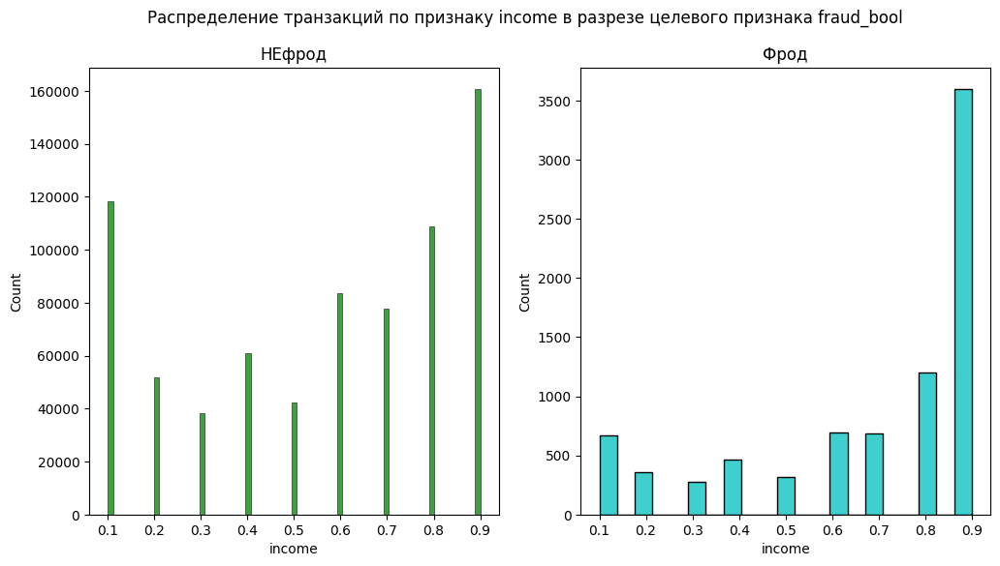

In [ ]:
histplot_by_fraud(data, 'income')

In [ ]:
grouped_data = data.groupby('income')['fraud_bool'].mean()
grouped_data.sort_values(ascending=False)

income
0.9    0.021905
0.8    0.010918
0.7    0.008795
0.6    0.008216
0.4    0.007540
0.5    0.007468
0.3    0.007289
0.2    0.006913
0.1    0.005647
Name: fraud_bool, dtype: float64

In [ ]:
grouped_data = data.groupby('customer_age')['fraud_bool'].mean()
grouped_data.sort_values(ascending=False)

customer_age
70    0.022912
80    0.021239
40    0.015912
60    0.014977
50    0.011092
30    0.010955
20    0.006420
10    0.004800
90    0.000000
Name: fraud_bool, dtype: float64

Как видим, ранги дохода не соответствуют рангом процента мошеннических атак по порядку. У возраста почти все идеально - кроме 90-летних. Думаю, что как и в случае с 'month', лучше их перекодировать:

*P.S. переписал функцию для кодирования месяца под более общий случай. Теперь это fraud_ranking().*

In [ ]:
# сохраняем мапперы
age_map = get_fraud_ranking(data, 'customer_age')
income_map = get_fraud_ranking(data, 'income')
# применяем к датафрейму
data['customer_age'] = data['customer_age'].map(age_map).fillna(0).astype('uint8')
data['income'] = data['income'].map(income_map).fillna(0).astype('uint8')

In [ ]:
save_data(data, 'data/bank_data_train.csv')

Теперь перейдем к остальным упомянутым признакам. Начнем с name_email_similarity:

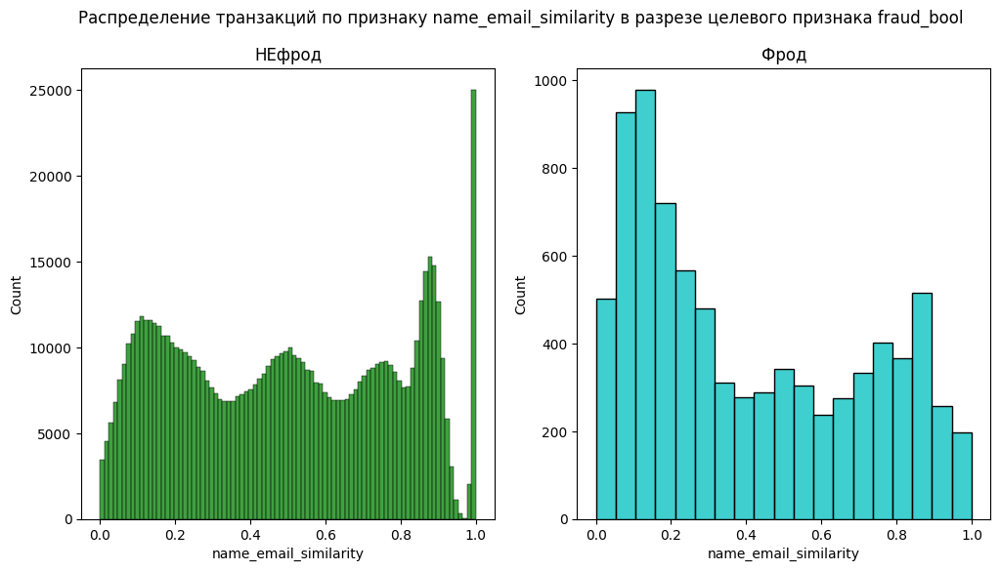

In [ ]:
histplot_by_fraud(data, 'name_email_similarity')

Видим, что name_email_similarity имеет волнистое, ненормальное распределение: видим пик мошеннических атак для низких значений (0.0 - 0.3), но и для значений в окрестности 0.9. Думаю, что нужно применить лог или квантильное преобразование распределения исходного признака, и разбить фичу на бины.

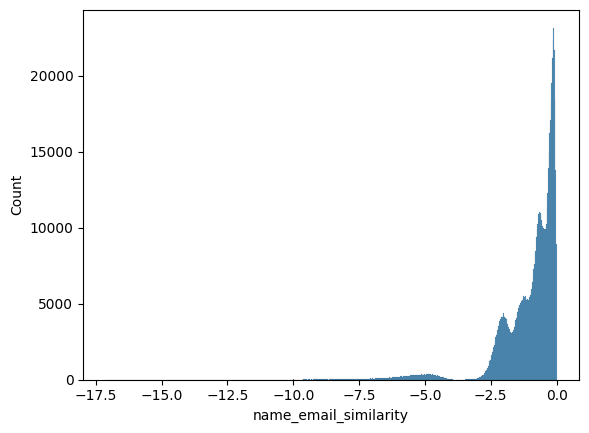

In [ ]:
sns.histplot(np.log(-data['name_email_similarity']+1));

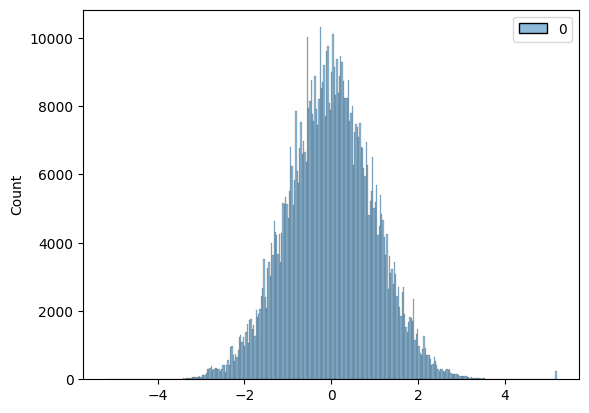

In [ ]:
quantile_transformer_similarity = preprocessing.QuantileTransformer(output_distribution='normal')
data_transformed = quantile_transformer_similarity.fit_transform(data[['name_email_similarity']])
sns.histplot(data_transformed);

Получилось довольно хорошее, симметричное нормальное распределение, поэтому оставим его.

Хотел создать признаки-флажки, но решил все-таки просто закодировать переменную. Так, из распределений видим, что (0.0 - 0.3] - самая опасная, (0.7 - 0.95] - вторая по опасности, (0.7 - 0.95] - умеренная опасность, а (0.95 - 1] - самая безопасная

In [ ]:
# категоризация фичи по бинам
data['n_e_cat_similarity'] = pd.cut(data['name_email_similarity'], bins=[0.0, 0.3, 0.7, 0.95, 1], \
       labels=[1, 0.5, 0.75, 0.25])
# сохраняем преобразование исходной фичи
data['n_e_norm_similarity'] = quantile_transformer_similarity.fit_transform(data[['name_email_similarity']])

Далее - session_length_in_minutes.

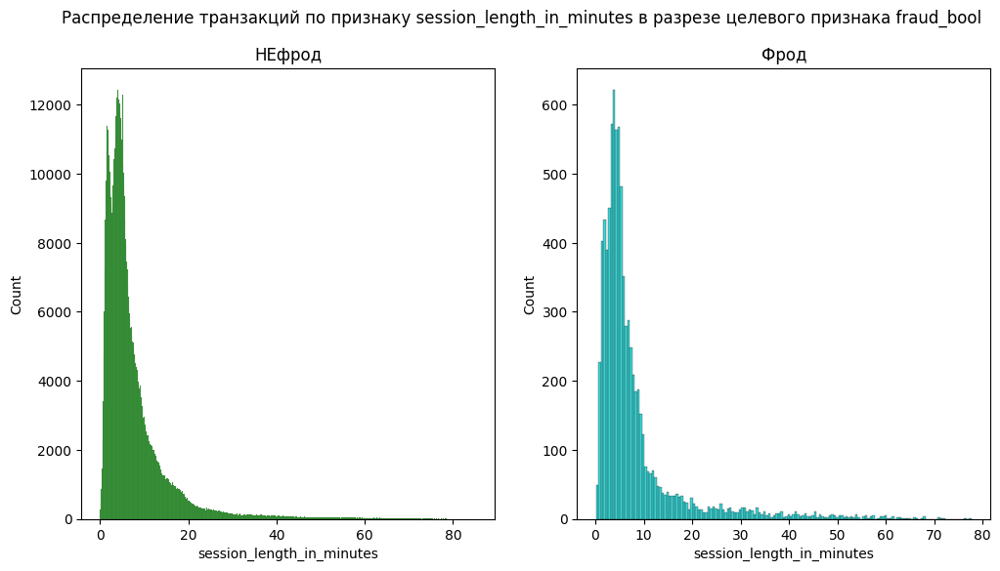

In [ ]:
histplot_by_fraud(data, 'session_length_in_minutes')

<Axes: xlabel='fraud_bool', ylabel='session_length_in_minutes'>

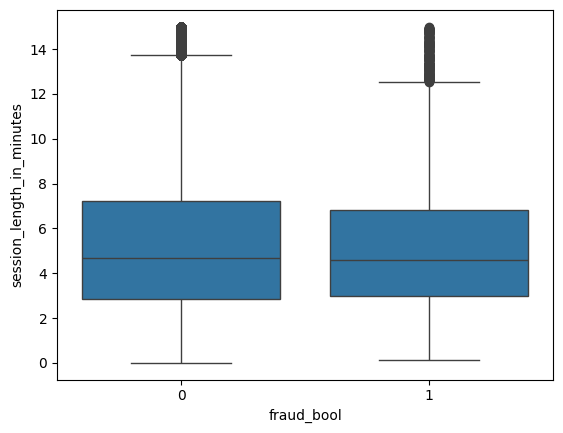

In [ ]:
sns.boxplot(data[data['session_length_in_minutes'] < 15], x='fraud_bool', y='session_length_in_minutes')

Видно, что 'session_length_in_minutes' имеет практически одинаковое распределение, но у мошеннических операций пик распределения спадает резче, чем у fraud_bool=0, иными словами - мошенники стараются как можно быстрее завершить сессию на сайте.

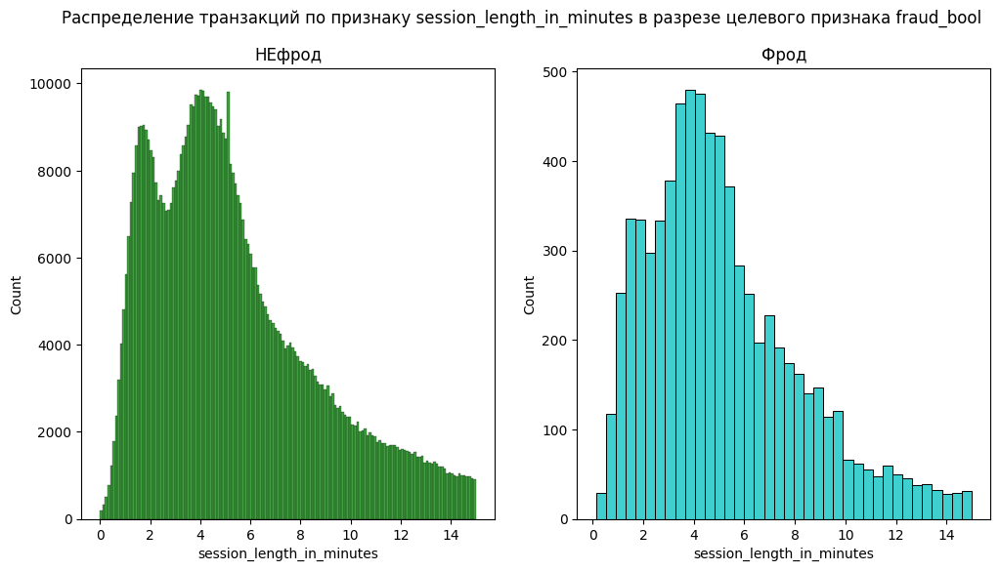

In [ ]:
histplot_by_fraud(data[data['session_length_in_minutes'] < 15], 'session_length_in_minutes')

А вот вблизи видно, что хотя у обычных пользователей в пределах 2-3 минут резкий спад в распределении, у мошенников значения не провисают, а также пик их активности приходится на чуть раньше чем у обычных пользователей. Разобьем наш признак на фичи, и в этот раз сделаем флаги:

*P.S. перепробовал различные разбиения, понял, что недосмотрел одну важную деталь: на примерно трети минуты происходит резкий всплеск мошеннических атак, а затем до 10 минуты идет такой "блок атак", после чего идет как раз спад.*

In [ ]:
# категоризуем фичу
data['session_binned'] = pd.cut(data['session_length_in_minutes'], bins=[0.0, 0.3, 10, 1000],
    labels=['first_normal', 'danger_spike', 'end_drop'])
# считаем и выводим информативность новых фичей
session_bins_frame = pd.get_dummies(data[['session_binned']])
print(list(session_bins_frame.columns), '\n', feature_selection.mutual_info_classif(session_bins_frame, data['fraud_bool']))

['session_binned_first_normal', 'session_binned_danger_spike', 'session_binned_end_drop'] 
 [0.         0.14919724 0.02045441]


Т.е. можем просто оставить флаг, идентифицирующий об опасном промежутке времени.

In [ ]:
data['danger_spike'] = session_bins_frame['session_binned_danger_spike']

In [ ]:
# удаляем ненужный датафрейм и признак
del(session_bins_frame)
data.drop('session_binned', axis=1, inplace=True)

Непосредственно сама переменная имеет лог-нормальное распределение, поэтому преобразуем ее:

In [ ]:
def log_transform(data, feature):
    return np.log(data[feature]+1)

data['session_length_in_minutes'] = log_transform(data, 'session_length_in_minutes')

---

'bank_months_count', 'current_address_months_count', 'days_since_request'

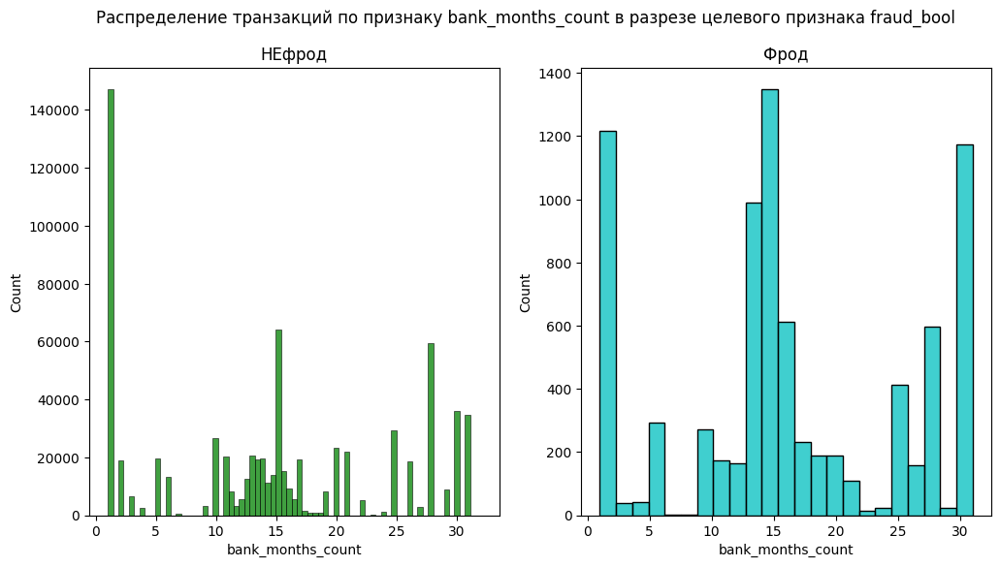

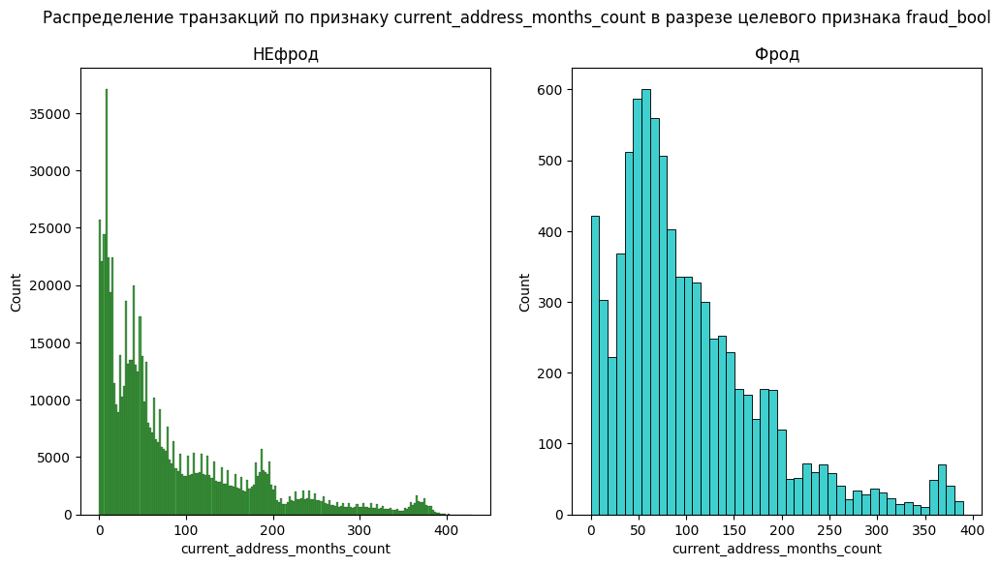

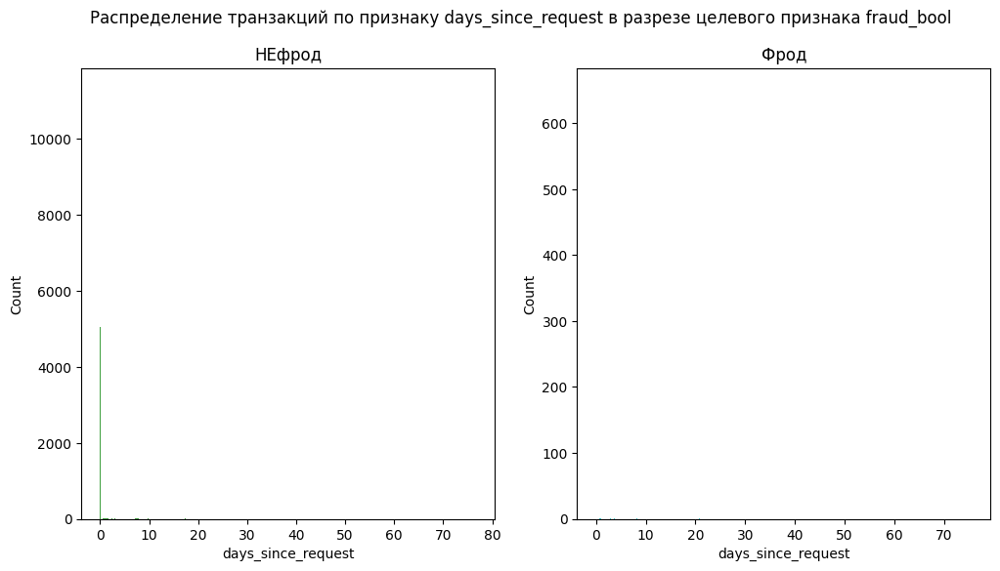

In [ ]:
histplot_by_fraud(data, 'bank_months_count')
histplot_by_fraud(data, 'current_address_months_count')
histplot_by_fraud(data, 'days_since_request')

Ситуация с 'current_address_months_count' довольна похожа с предыдущим признаком.

In [ ]:
# категоризуем фичу
data['cur_address_months_binned'] = pd.cut(data['current_address_months_count'], bins=[0.0, 25, 200, 1000],
    labels=['first_spike', 'danger_spike', 'end_drop'])
# считаем и выводим информативность новых фичей
address_bins_frame = pd.get_dummies(data[['cur_address_months_binned']])
mutual_info = feature_selection.mutual_info_classif(address_bins_frame, data['fraud_bool'])
print(list(address_bins_frame.columns), '\n', mutual_info)
print('\nTotal mutual info score:', np.sum(mutual_info))

['cur_address_months_binned_first_spike', 'cur_address_months_binned_danger_spike', 'cur_address_months_binned_end_drop'] 
 [0.0396843  0.13186265 0.00519181]

Total mutual info score: 0.17673875688213303


Логи значений, которые я проверял:

[0.0, 25, 200, 1000]

['cur_address_months_binned_first_spike', 'cur_address_months_binned_danger_spike', 'cur_address_months_binned_end_drop'] 
 [0.03997102 0.13155767 0.00538933]

Total mutual info score: 0.17691802287004244

[0.0, 200, 1000]
['cur_address_months_binned_danger_spike', 'cur_address_months_binned_end_drop'] 
 [0.13459782 0.00524447]

Total mutual info score: 0.13984229509031254

[0.0, 25, 80, 200, 1000]

Total mutual info score: 0.1361374646374637

In [ ]:
# присоединяем датафрейм с бинами к исходному
data = pd.concat([data, address_bins_frame], axis=1)
# удаляем ненужный датафрейм
del(address_bins_frame)

А вот с преобразованием беда: ни лог, ни квантили далеки от идеала. Бокс-Кокс и Йео-Джонсон также не сильно помогают сделать распределение признака нормальным. Остановился на Йео-Джонсон как на самом быстром:

<Axes: ylabel='Count'>

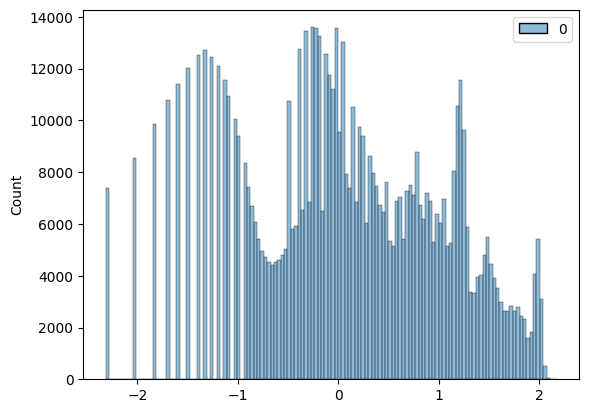

In [ ]:
from sklearn.preprocessing import PowerTransformer

power_transformer_cur_address = PowerTransformer(method='yeo-johnson')
sns.histplot(power_transformer_cur_address.fit_transform(data[['current_address_months_count']]))

Решил посмотреть на распределения в разрезе целевой переменной и обнаружил разность в распределениях!

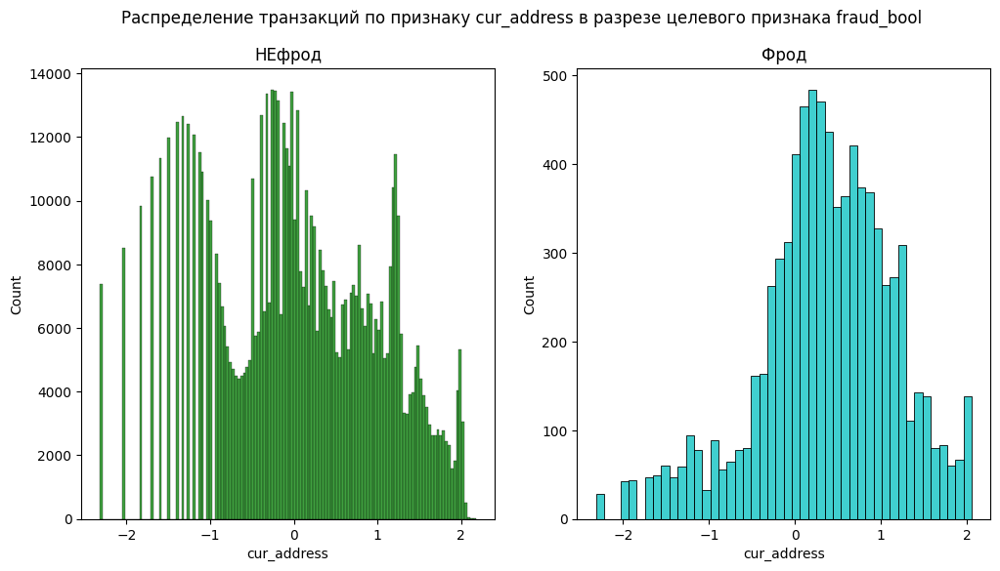

In [ ]:
data['cur_address'] = power_transformer_cur_address.fit_transform(data[['current_address_months_count']])
histplot_by_fraud(data, 'cur_address')

Отдельно создал флаг-признак, показывающий нахождение в "зоне риска" - в интервале с (-0.5) до (1.5).

In [ ]:
data['cur_address_fraud_zone'] = ((data['cur_address'] > -0.5) & (data['cur_address'] < 1.5)).astype('uint8')

In [ ]:
save_data(data, 'data/bank_data_train_1.csv')

In [ ]:
data = open_data('data/bank_data_train_1.csv')

Продолжим еще более интересным признаком - days_since_request. Из ProfileReport увидел, что в нем содержатся не чисто натуральные числа (нули), т.е. переменная непрерывна и содержит нецелые числа:

In [ ]:
data['days_since_request'].unique()

array([0.02734322, 0.00750447, 0.00272327, ..., 0.01452223, 0.02141686,
       0.02010562])

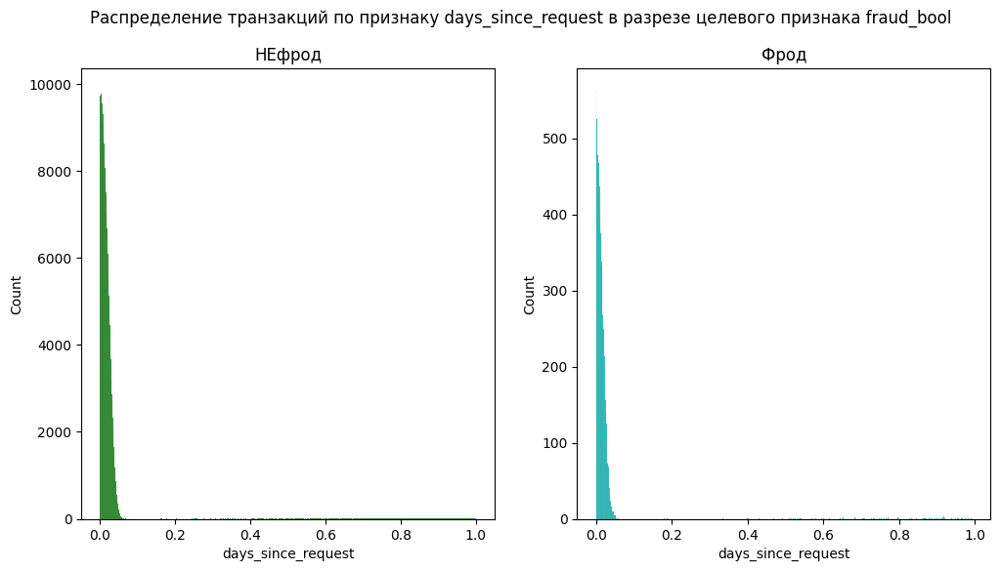

In [ ]:
# из распределения видно, что большинство значений лежат в промежутке (0, 1)
histplot_by_fraud(data[data['days_since_request'] < 1], 'days_since_request')

In [ ]:
data['days_since_request'].max()

76.63502193552573

In [ ]:
np.arange(start=0, stop=77)

array([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16,
       17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33,
       34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50,
       51, 52, 53, 54, 55, 56, 57, 58, 59, 60, 61, 62, 63, 64, 65, 66, 67,
       68, 69, 70, 71, 72, 73, 74, 75, 76])

<Axes: >

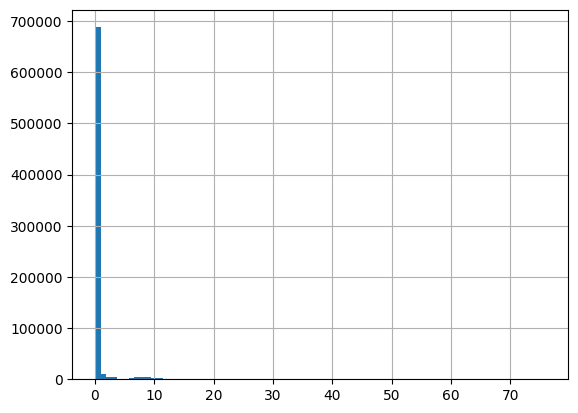

In [ ]:
data['days_since_request_binned'] = pd.cut(data['days_since_request'], bins=np.arange(0, 78), labels=np.arange(0, 77))
data['days_since_request_binned'].hist(bins=80)

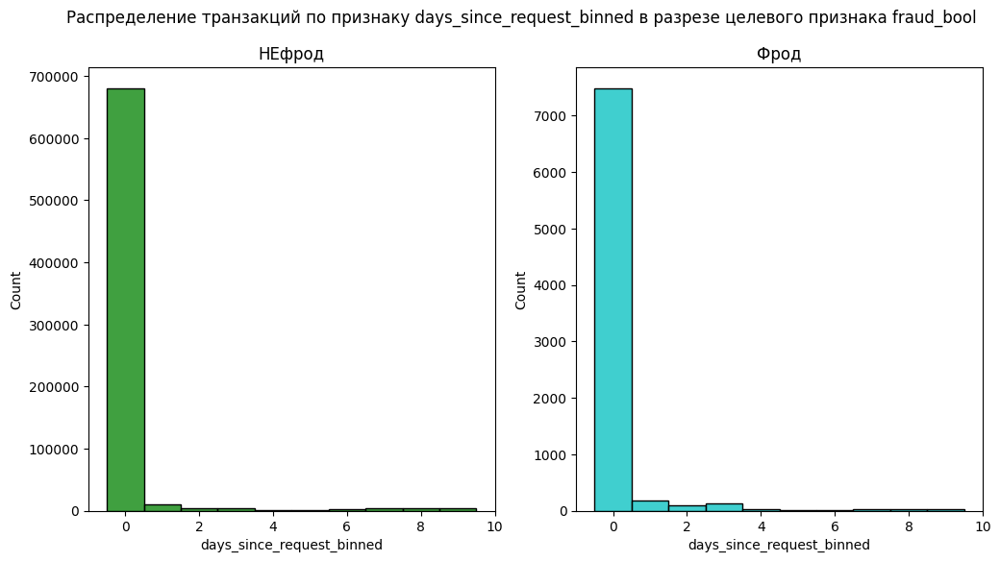

In [ ]:
histplot_by_fraud(data[data['days_since_request_binned'] < 10], 'days_since_request_binned')

P.S. Придумал еще одну фичу - отношение давности реквеста к времени жизни аккаунта.

In [ ]:
data['recency_to_lifetime_ratio'] = data['days_since_request'] / (data['bank_months_count'] * 30 + 1)

In [ ]:
# создаем флажок - недавний запрос
data['is_recent_request'] = (data['days_since_request_binned'] <= 3).astype('uint8')
# удаляем лишнее
data.drop(['days_since_request_binned'], axis=1, inplace=True)

---

bank_months_count - как давно существовал предыдущий банковский аккаунт пользователя. Оставил его последним, т.к. признак имеет необычное распределение с тремя пиками.
Исходную фичу преобразуем, а также создадим флаги, идентифицирующие пики, и посмотрим, лучше ли использовать флаг под любой пик, флаг на какие-то пики можно объединить (так, самым опасным, судя по распределению, периодом является 13-16 дней)

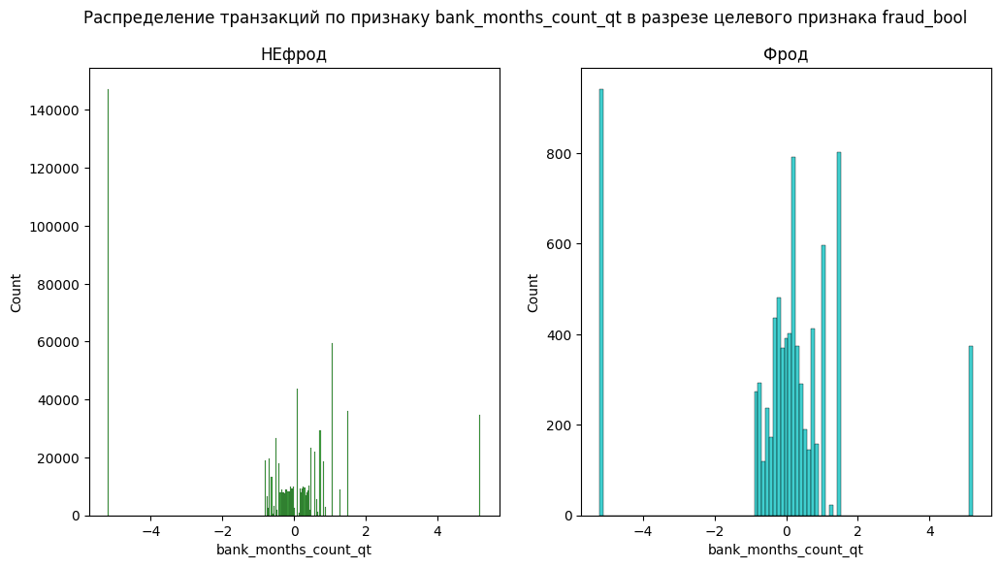

In [ ]:
# применяем квантильное преобразование к фиче
qt = preprocessing.QuantileTransformer(output_distribution='normal')
data['bank_months_count_qt'] = qt.fit_transform(data[['bank_months_count']])
histplot_by_fraud(data, 'bank_months_count_qt')

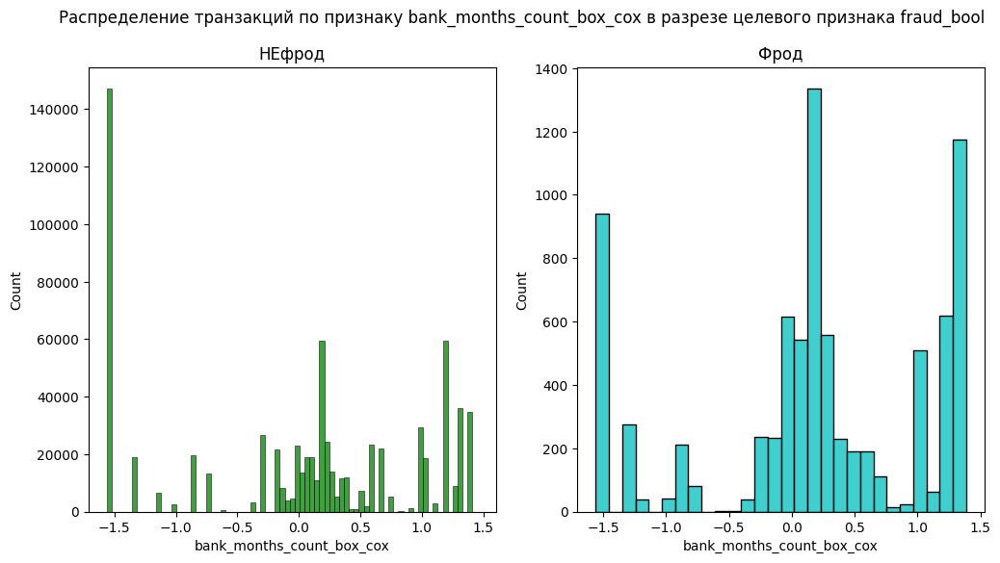

In [ ]:
# применяем преобразование Бокса-Кокса к фиче
box_cox_bank_months = preprocessing.PowerTransformer(method='box-cox')
data['bank_months_count_box_cox'] = box_cox_bank_months.fit_transform(data[['bank_months_count']])
histplot_by_fraud(data, 'bank_months_count_box_cox')

Бокс-Кокс дольше считается, и при Квантильном преобразовании лучше видна разница в распределениях - поэтому оставим последний вариант.

In [ ]:
data.drop('bank_months_count_box_cox', axis=1, inplace=True)

In [ ]:
# создаем флаги-признаки для каждого пика
data['bank_months_0_2'] = (data['bank_months_count'] <= 2).astype('uint8')
data['bank_months_13_16'] = data['bank_months_count'].between(13, 16).astype('uint8')
data['bank_months_27_30'] = data['bank_months_count'].between(27, 30).astype('uint8')

Есть предчувствие, что вместо отдельных флагов под каждый пик можно либо создать один под все, либо объединить два сильных (13-16 дней и 27-30). Проверим информативность фичей с помощью ROC-AUC:

Посчитаем информативности каждой отдельной переменной:

In [ ]:
print('ROC_AUC для bank_months_0_2:', round(metrics.roc_auc_score(data['fraud_bool'], data['bank_months_0_2']), 3))
print('ROC_AUC для bank_months_13_16:', round(metrics.roc_auc_score(data['fraud_bool'], data['bank_months_13_16']), 3))
print('ROC_AUC для bank_months_27_30:', round(metrics.roc_auc_score(data['fraud_bool'], data['bank_months_27_30']), 3))

ROC_AUC для bank_months_0_2: 0.462
ROC_AUC для bank_months_13_16: 0.537
ROC_AUC для bank_months_27_30: 0.517


Теперь посчитаем их информативность для целевой переменной вместе:

In [ ]:
X_multi = data[['bank_months_13_16', 'bank_months_0_2', 'bank_months_27_30']]
y = data['fraud_bool']

model = linear_model.LogisticRegression(max_iter=1000)
cv = model_selection.StratifiedKFold(n_splits=5, shuffle=True, random_state=42)
auc_multi = model_selection.cross_val_score(model, X_multi, y, cv=cv, scoring='roc_auc').mean()

print(f'AUC (три флага): {auc_multi:.4f}')

AUC (три флага): 0.5686


Считаем информативность для признака "любое пиковое значение":

In [ ]:
data['bank_months_peak'] = (data['bank_months_13_16'] | data['bank_months_0_2'] 
                            | data['bank_months_27_30']).astype('uint8')
X_single = data[['bank_months_peak']]

auc_single = model_selection.cross_val_score(model, X_single, y, cv=cv, scoring='roc_auc').mean()

print(f'AUC (один флаг): {auc_single:.4f}')

AUC (один флаг): 0.5158


И, наконец, попробуем объединить два сильных пика в один признак: 

In [ ]:
data['bank_months_strong_peak'] = (data['bank_months_13_16'] | data['bank_months_27_30']).astype('uint8')
X_two = data[['bank_months_strong_peak', 'bank_months_0_2']]
auc_two = model_selection.cross_val_score(model, X_two, y, cv=cv, scoring='roc_auc').mean()

print(f'AUC (один флаг): {auc_two:.4f}')

AUC (один флаг): 0.5669


Как видим, AUC осталась практически прежней. Итого оставляем признаки: 'bank_months_count_qt', 'bank_months_strong_peak' и 'bank_months_0_2'.

In [ ]:
data.drop(['bank_months_peak', 'bank_months_13_16', 'bank_months_27_30'], axis=1, inplace=True)

In [ ]:
data.info()

<class 'pandas.core.frame.DataFrame'>
Index: 750000 entries, 634102 to 471855
Data columns (total 65 columns):
 #   Column                                  Non-Null Count   Dtype  
---  ------                                  --------------   -----  
 0   fraud_bool                              750000 non-null  int64  
 1   income                                  750000 non-null  int64  
 2   name_email_similarity                   750000 non-null  float64
 3   current_address_months_count            750000 non-null  int64  
 4   customer_age                            750000 non-null  int64  
 5   days_since_request                      750000 non-null  float64
 6   intended_balcon_amount                  750000 non-null  float64
 7   payment_type                            750000 non-null  object 
 8   zip_count_4w                            750000 non-null  int64  
 9   velocity_6h                             750000 non-null  float64
 10  velocity_24h                            7500

Новый признак - кол-во транзакций на кол-во месяцев жизни аккаунта (оказался не очень удалил).

In [ ]:
# преобразование фичей из bool в 'uint8'
data['cur_address_months_binned_first_spike'] = data['cur_address_months_binned_first_spike'].astype('uint8')
data['cur_address_months_binned_danger_spike'] = data['cur_address_months_binned_danger_spike'].astype('uint8')
data['cur_address_months_binned_end_spike'] = data['cur_address_months_binned_danger_spike'].astype('uint8')

In [ ]:
# еще удаляем лишние фичи
data.drop(['cur_address_months_binned'], axis=1, inplace=True)

---

'proposed_credit_limit', 'intended_balcon_amount', 'date_of_birth_distinct_emails_4w' - начнем с конца:

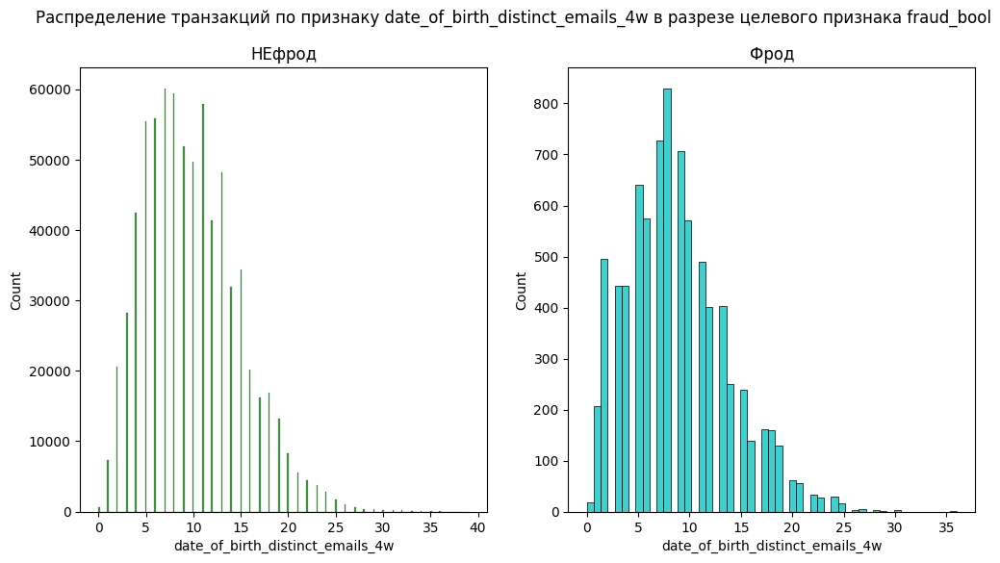

In [ ]:
histplot_by_fraud(data, 'date_of_birth_distinct_emails_4w')

<Axes: >

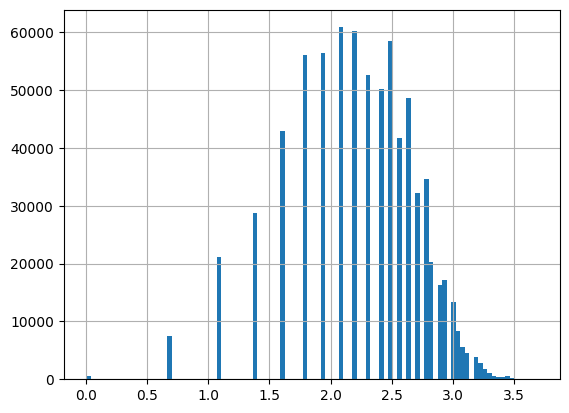

In [ ]:
np.log(data['date_of_birth_distinct_emails_4w']+1).hist(bins=100)

То же, что и раньше - преобразуем саму переменную 'date_of_birth_distinct_emails_4w' (видим, что она очень хороше логарифмируется), и создадим флажок для пикового значения.

In [ ]:
# создаем признак-флажок пика
data['births_danger_zone'] = (data['date_of_birth_distinct_emails_4w'] < 11) \
    & (data['date_of_birth_distinct_emails_4w'] >= 1).astype('uint8')
metrics.mutual_info_score(data['fraud_bool'], data['births_danger_zone'])

0.00023457755942417335

In [ ]:
# преобразуем исходную фичу
data['birth_distinct_emails_logged'] = log_transform(data, 'date_of_birth_distinct_emails_4w')

In [ ]:
data

,fraud_bool,income,name_email_similarity,current_address_months_count,customer_age,days_since_request,intended_balcon_amount,payment_type,zip_count_4w,velocity_6h,...,cur_address,cur_address_fraud_zone,recency_to_lifetime_ratio,is_recent_request,bank_months_count_qt,bank_months_0_2,bank_months_strong_peak,cur_address_months_binned_end_spike,births_danger_zone,birth_distinct_emails_logged
634102,0,7,0.546775,375,3,0.027343,-0.654816,AB,1455,3871.735367,...,2.006987,0,0.000043,1,0.580524,0,0,0,True,2.197225
173005,0,8,0.715285,379,4,0.007504,18.068853,AA,1086,9501.114204,...,2.020068,0,0.000017,1,0.079120,0,1,0,True,1.791759
40774,0,4,0.426694,32,6,0.002723,-1.068231,AC,1681,5981.928956,...,-0.380984,1,0.000007,1,-0.109431,0,1,1,True,2.079442
606711,0,8,0.117964,131,6,0.007622,-0.443271,AC,1223,8830.037024,...,0.838722,1,0.000018,1,-0.088749,0,1,1,False,2.484907
429877,0,2,0.486578,9,6,1.145359,-1.527414,AC,2096,8416.753206,...,-1.195479,0,0.002223,1,0.384375,0,0,0,True,2.397895
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
187743,0,6,0.438287,18,3,0.000520,-0.633358,AB,5258,7070.136677,...,-0.781409,0,0.000002,1,-0.520661,0,0,0,False,2.772589
126160,0,4,0.478246,116,3,0.006935,-0.842437,AC,1454,7215.967170,...,0.718899,1,0.000017,1,-0.122078,0,1,1,True,1.945910
941678,0,4,0.571138,4,2,0.014522,-1.019282,AA,989,1873.437923,...,-1.587694,0,0.000033,1,-0.018253,0,1,0,True,2.197225
903476,0,8,0.061641,37,2,0.021417,-1.148033,AB,421,3399.896222,...,-0.271493,1,0.000025,1,1.048748,0,1,1,True,2.397895


---

Теперь - proposed_credit_limit. Из EDA понимаем, что верхняя квартиль признака для нефрод операции находится на уровне медианы мошеннической транзакции. Т.е. нам будет полезен признак "высокий ли доход или нет?".

In [ ]:
data['is_credit_limit_high'] = data['proposed_credit_limit'].apply(lambda x: 1 if x >= 500 else 0)

In [ ]:
data['proposed_credit_limit'].value_counts()

proposed_credit_limit
200.0     465007
1500.0    105464
500.0     102681
1000.0     60384
990.0       5522
510.0       5059
2000.0      4247
490.0        742
210.0        459
1900.0       287
190.0        110
2100.0        38
Name: count, dtype: int64

Придумал новый признак, возможно, будет полезен - максимальное кол-во денег, которые можно вывести с аккаунта, умноженное на кол-во месяцев (т.е. максимально возможная сумма вывода за месяц). Проблема в том, что неизвестно, на какой срок дается этот кредитынй лимит, может ли он быть повышен и т.д. (спросил у создателей на kaggle, пока ответа нет). Но попробовать стоит - если фича окажется неинформативной, просто отсеем ее на этапе отбора.

In [ ]:
data['max_account_sum'] = data['bank_months_count'] * data['proposed_credit_limit']
data['account_sum_by_month'] = data['proposed_credit_limit'] / data['bank_months_count']

In [ ]:
save_data(data, 'data/bank_data_train_2.csv')

Наконец, intended_balcon_amount. Про него написал сам автор датасета:

![image.png](logs/screenshot.png)

Если переводить и резюмировать, то автор сказал, что эта фича имеет очень много пропусков в изначальных, и за них отвечают отрицательные значения в нашем датасете. Тем не менее, фичакоррелирует с fraud_bool даже как она представлена, а какая-либо ее трансформация может повлечь потерю информативностью

<Axes: >

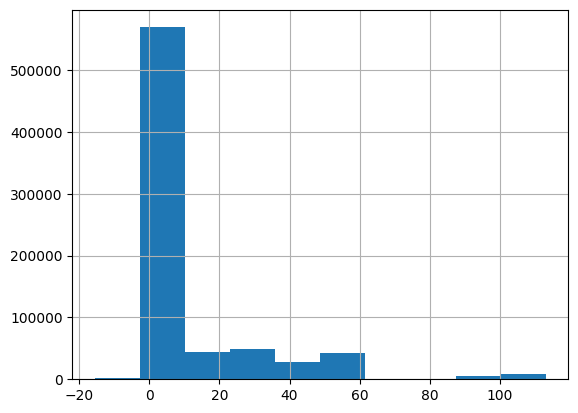

In [ ]:
data['intended_balcon_amount'].hist()

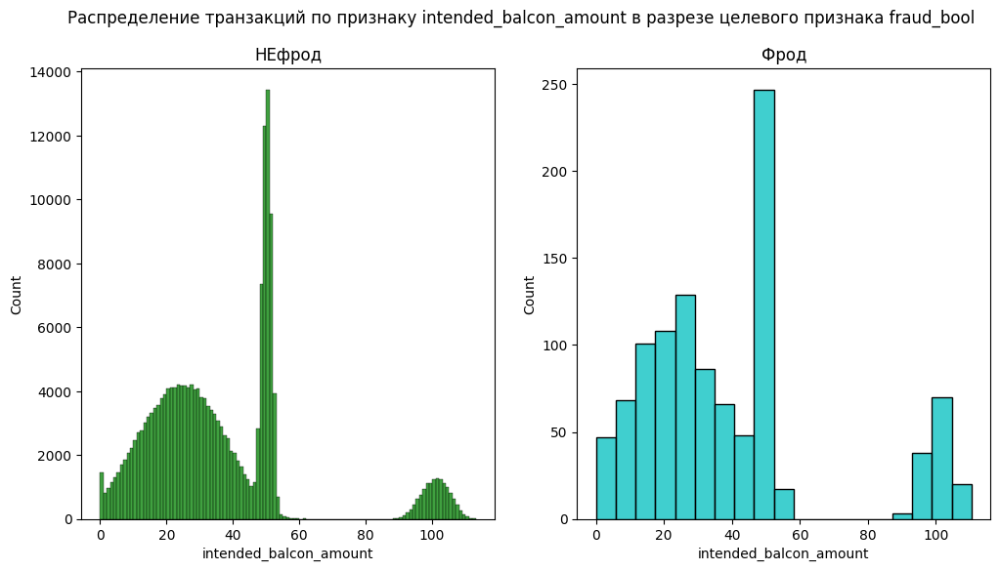

In [ ]:
histplot_by_fraud(data[data['intended_balcon_amount'] >=0 ], 'intended_balcon_amount')

In [ ]:
data[data['intended_balcon_amount'] >=0 ].shape[0]

195126

<Axes: >

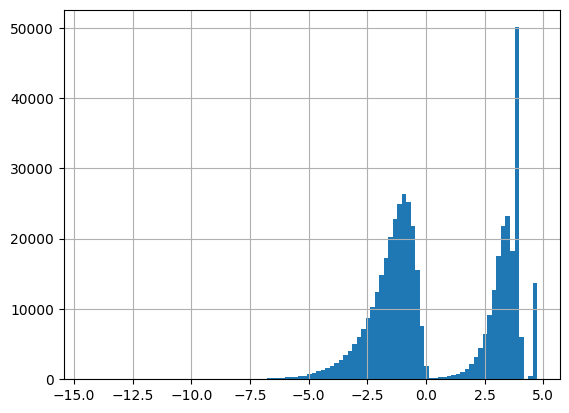

In [ ]:
np.log(data['intended_balcon_amount']+1).hist(bins=100)

Итак, судя по графикам выше, разумнее всего действительно оставить фичу как есть, но попробовать создать на ее основе признаки по пикам:

In [ ]:
data['intended_balcon_amount']

634102    -0.654816
173005    18.068853
40774     -1.068231
606711    -0.443271
429877    -1.527414
            ...    
187743    -0.633358
126160    -0.842437
941678    -1.019282
903476    -1.148033
471855    -1.038373
Name: intended_balcon_amount, Length: 750000, dtype: float64

In [ ]:
data['intended_balcon_peak_1'] = ((data['intended_balcon_amount'] > 0 )
                                  & (data['intended_balcon_amount'] < 60)).astype('uint8')
data['intended_balcon_peak_2'] = (data['intended_balcon_amount'] >= 85).astype('uint8')

feature_selection.mutual_info_classif(data[['intended_balcon_peak_1', 'intended_balcon_peak_2']], data['fraud_bool'])

array([0.02912987, 0.00030523])

In [ ]:
# удаляем неинформативную фичу
data.drop('intended_balcon_peak_2', axis=1, inplace=True)

Думал создать фичу, которая индицирует аккаут с большим кредитным лимитом и большой суммой вывода (самое то для недоброжелателей!), но фича оказалась неинформативна:

In [ ]:
data['cash_account'] = ((data['intended_balcon_peak_1']) & (data['is_credit_limit_high'])).astype('uint8')
metrics.mutual_info_score(data['fraud_bool'], data['cash_account'])

9.027930447716784e-05

In [ ]:
data.drop('cash_account', axis=1, inplace=True)

---

In [ ]:
save_data(data, 'data/bank_train_2.csv')

4. 'zip_count_4w', 'device_distinct_emails_8w', 'bank_branch_count_8w', 'credit_risk_score' - оставшиеся признаки.

Начнем с 'device_distinct_emails_8w' - вроде незамудренный признак, всего три значения.

In [ ]:
data['device_distinct_emails_8w'].value_counts()

device_distinct_emails_8w
1    727824
2     17576
0      4600
Name: count, dtype: int64

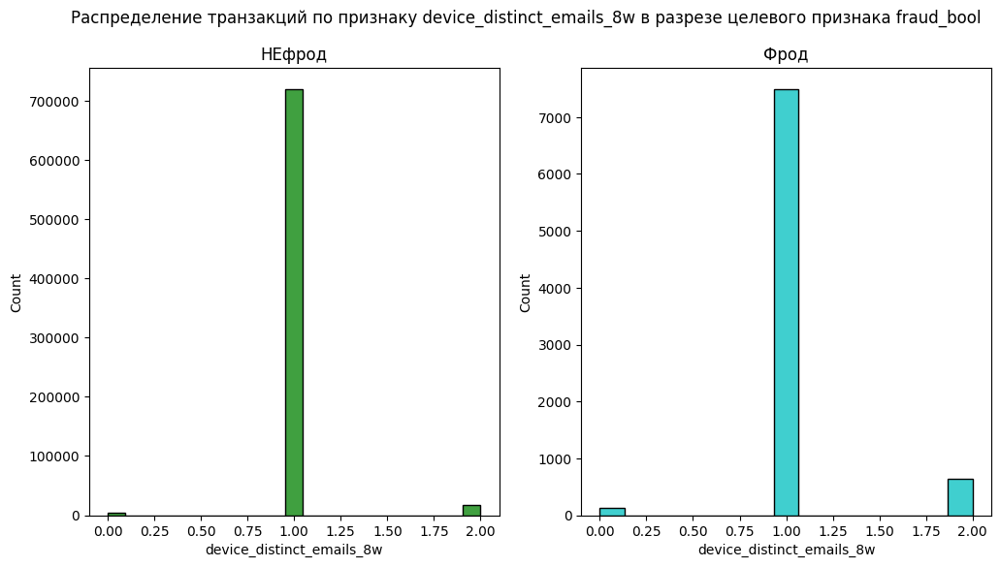

In [ ]:
histplot_by_fraud(data, 'device_distinct_emails_8w')

Не сказать что признак сам по себе информативный - большинство значений - это 1. Тут нужно сделать флажок-признак либо "производился ли вход с аккаунта вообще" или "производился ли вход в аккаунт с более чем одного уникального устройства" (судя по распределению, склоняюсь к первой фиче):

In [ ]:
data['has_entered_website_recently'] = data['device_distinct_emails_8w'].apply(lambda x: x > 0)
data['new_email_entrance'] = data['device_distinct_emails_8w'].apply(lambda x: x == 2)

feature_selection.mutual_info_classif(data[['has_entered_website_recently', 'new_email_entrance']], data['fraud_bool'])

array([0.14873387, 0.00102684])

Ну и действительно, видим хороший показатель для первой фичи.

А вот интереснее исследовать связь с другим признаком - 'device_distinct_emails_8w' - кол-во уникальных почт в базе данных банка с такой датой рождения.

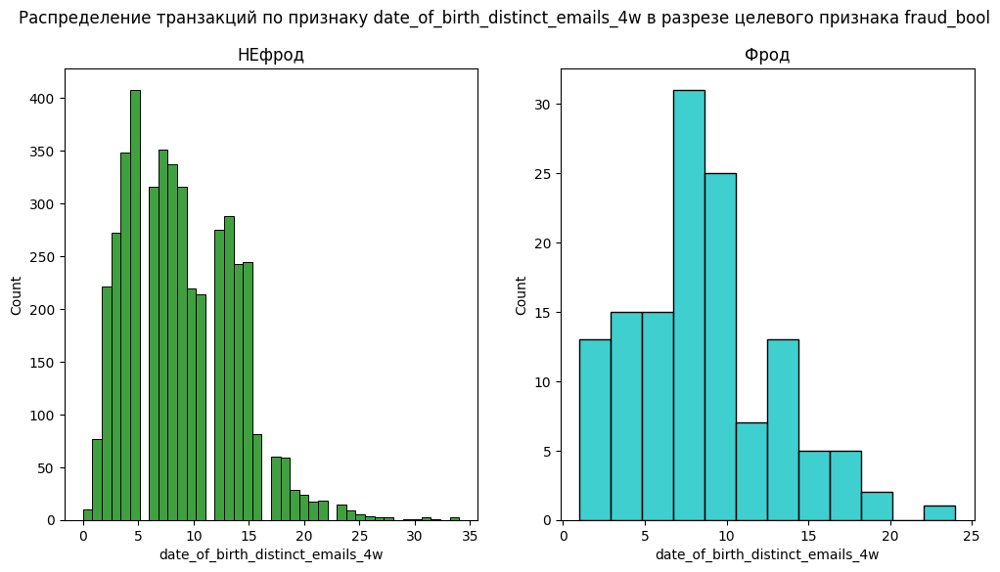

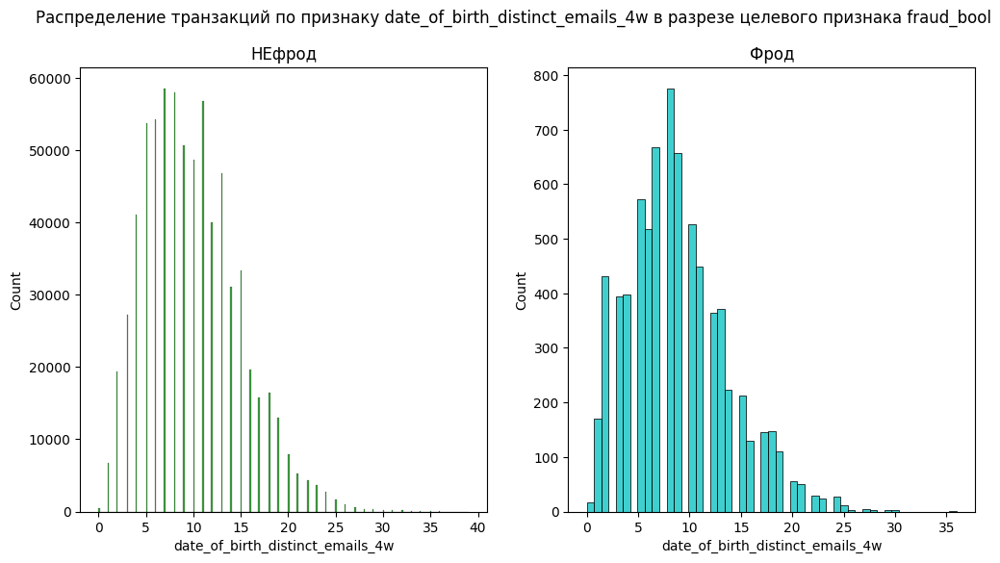

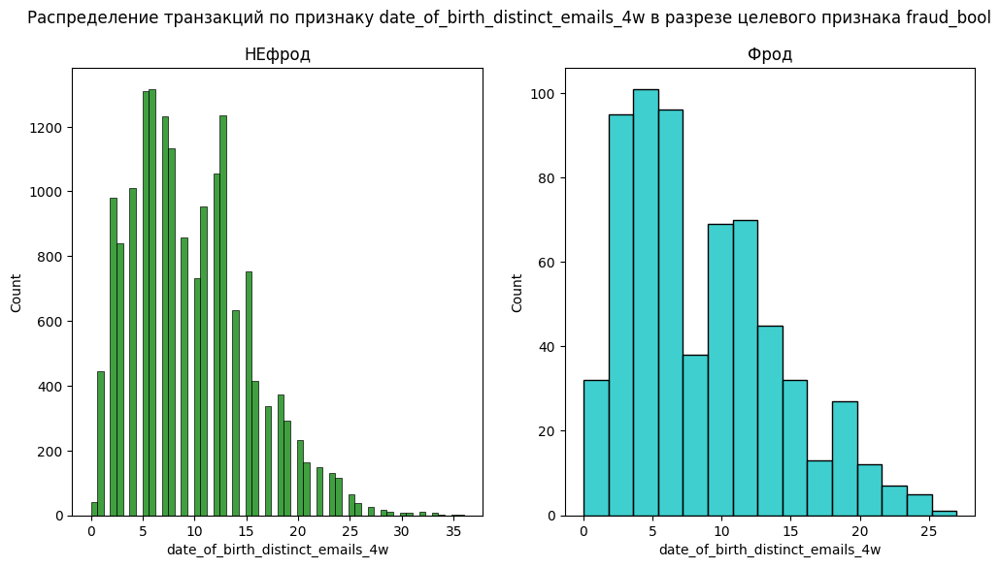

In [ ]:
histplot_by_fraud(data[data['device_distinct_emails_8w'] == 0], 'date_of_birth_distinct_emails_4w')
histplot_by_fraud(data[data['device_distinct_emails_8w'] == 1], 'date_of_birth_distinct_emails_4w')
histplot_by_fraud(data[data['device_distinct_emails_8w'] == 2], 'date_of_birth_distinct_emails_4w')

Ну и видим разные распределения в разрезе. Но у всех ник пик примерно в 1-11 днях (т.е. тот же самый признак 'births_danger_zone'), поэтому отдельные флаги создавать не будем.

---

'bank_branch_count_8w' - мы уже создали признак с ним ранее совместно с bank_months_count, но рассмотрим его и отдельно.

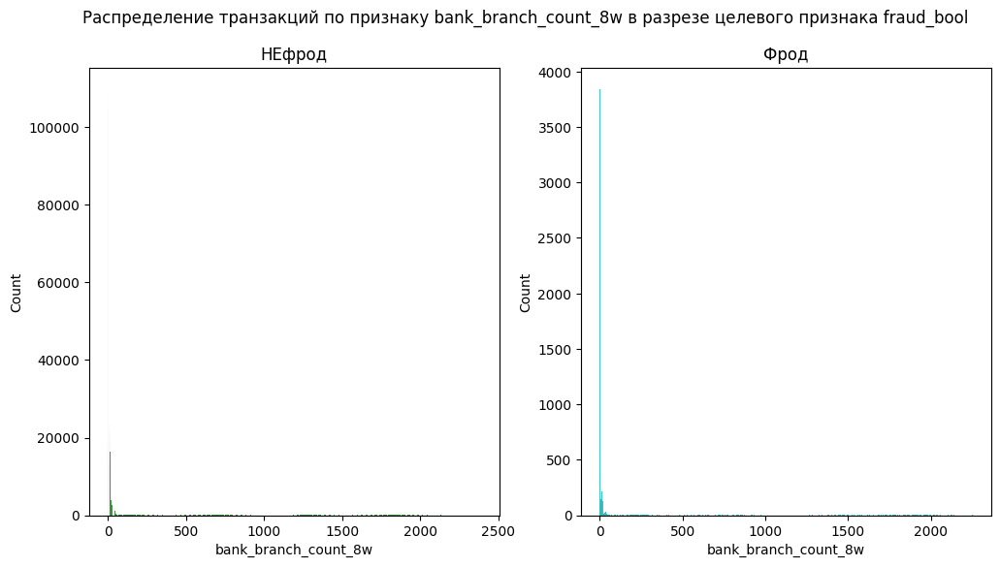

In [ ]:
histplot_by_fraud(data, 'bank_branch_count_8w')

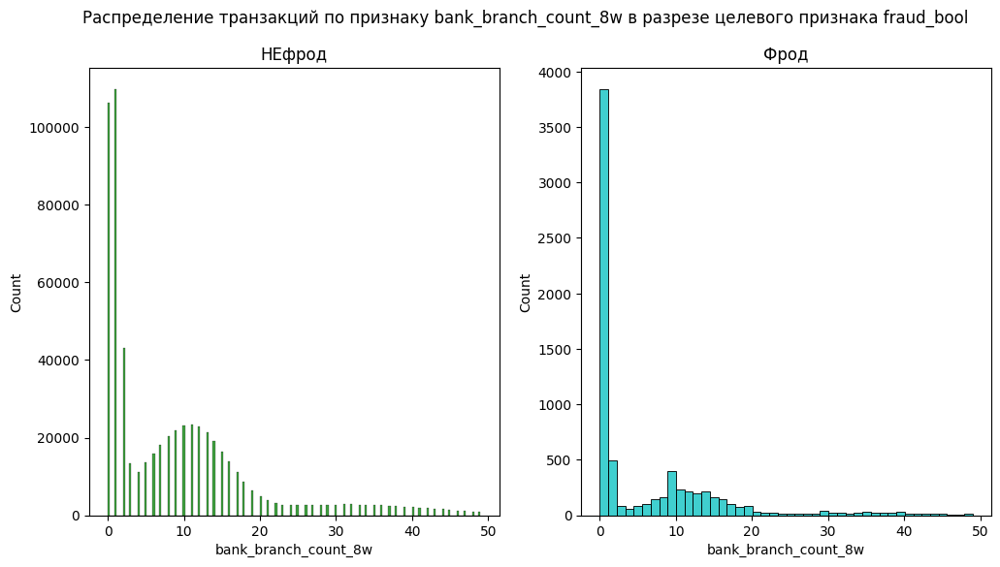

In [ ]:
histplot_by_fraud(data[data['bank_branch_count_8w'] < 50], 'bank_branch_count_8w')

Видим, что большинство клиентов совершают в среднем 2-3 транзакции каждые 2 месяца, но в это же время столько же операций совершают большинство мошенников. Разобьем признак на квантили:

In [ ]:
# разрезаем фичу по квантилям
bank_branch_count_q = pd.qcut(data['bank_branch_count_8w'], q=4, labels=['q1', 'q2', 'q3', 'q4'])
# разбиваем на флаги
bank_branch_frame = pd.get_dummies(bank_branch_count_q).astype('uint8')
# создаем новую фичу
data['bank_branch_peak'] = (bank_branch_frame['q1'] | bank_branch_frame['q3']).astype('uint8')
# удаляем ненужное
del(bank_branch_count_q, bank_branch_frame)

---

'zip_count_4w'

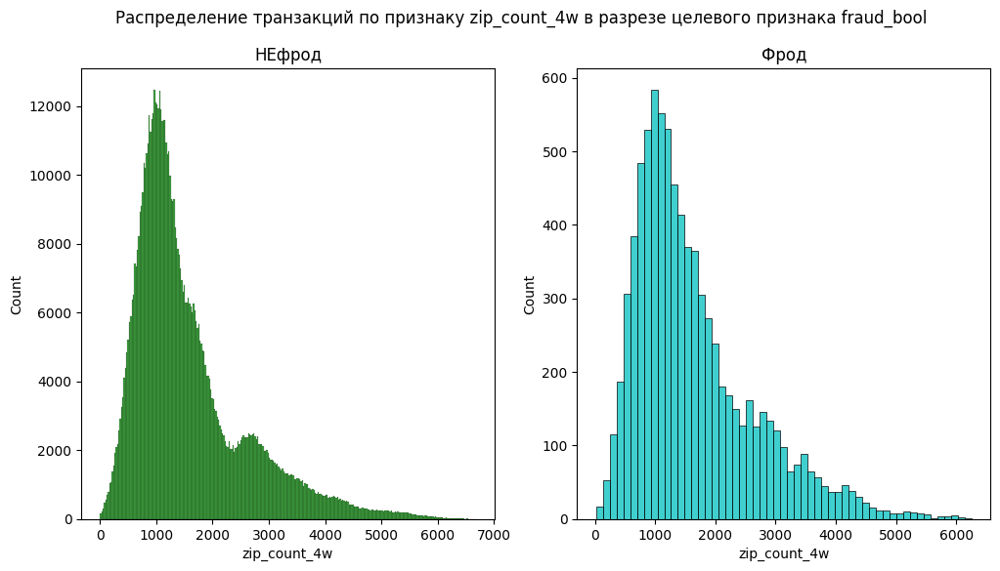

In [ ]:
histplot_by_fraud(data, 'zip_count_4w')

Стандартно: преобразуем (логарифмирование показало себя почти хорошо, но правый край все-таки имеет второй пик, Йео-Джонсон справился хуже), поставим флажок, НО еще создадим вот такие фичи: процент транзакций с данного место от общего кол-ва за 4 недели (необычно, правда? а то устал уже от однотипных флажков), макс. сумма на кол-во транзакций с данного места и сумма делить на место:

<Axes: >

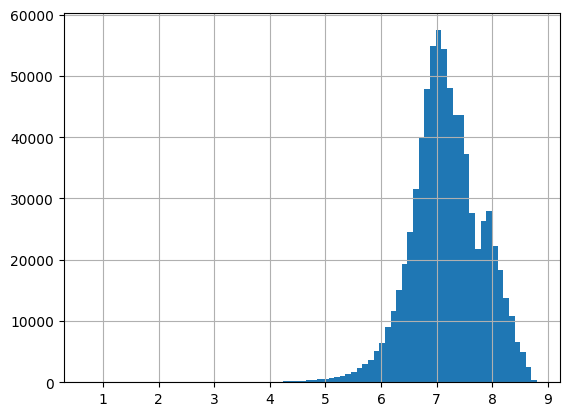

In [ ]:
np.log(data['zip_count_4w']+1).hist(bins=80)

In [ ]:
data['bank_branch_count_8w']

,bank_branch_count_8w,bank_branch_count_8w
634102,14,q3
173005,748,q4
40774,0,q1
606711,0,q1
429877,0,q1
...,...,...
187743,11,q3
126160,1,q1
941678,2,q2
903476,7,q2


In [ ]:
# преобразование исходной фичи
data['zip_logged'] = log_transform(data, 'zip_count_4w')
# флажок
data['zip_peak'] = ((data['zip_count_4w'] > 150) & (data['zip_count_4w'] <= 3200)).astype('uint8')
# необычные фичи
data['zip_transaction_ratio'] = data['zip_count_4w'] * 2 / (data['bank_branch_count_8w']+1)
data['max_zip_sum'] = data['zip_count_4w'] * data['proposed_credit_limit']
data['zip_sum_ratio'] = data['zip_count_4w'] / data['proposed_credit_limit'] 

---

Финальный - credit_risk_score. Как мы помним, в распределении он показывал значительную разницу в распределениях. В принципе, как-то его перемножить с чем-то не вариант, разные размерности и смыслы. Посмотрим на распределения.

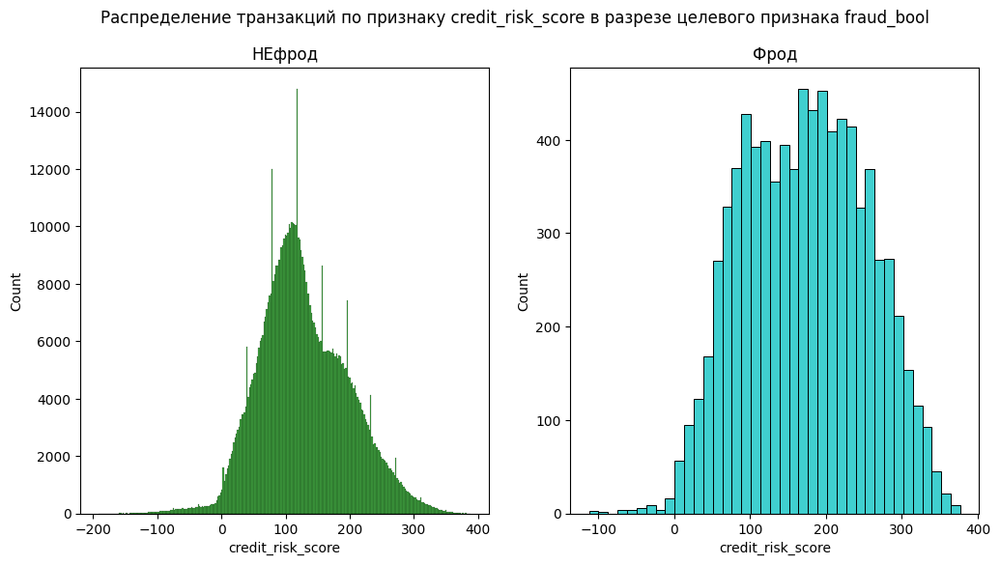

In [ ]:
histplot_by_fraud(data, 'credit_risk_score')

Видим абсолютно разные распределения. В фроде похоже на нормальное (хотя скорее Стьюдента) с более пологим верхом, медиана примерно в значении 180, у НЕфрода - более высокий колокол с горкой справа, медиана примерно в 110.

#### ИТОГО:

In [ ]:
data

,fraud_bool,income,name_email_similarity,current_address_months_count,customer_age,days_since_request,intended_balcon_amount,payment_type,zip_count_4w,velocity_6h,...,intended_balcon_peak_1,has_entered_website_recently,new_email_entrance,zip_logged,zip_peak,bank_branch_count_8w,bank_branch_peak,zip_transaction_ratio,max_zip_sum,zip_sum_ratio
634102,0,7,0.546775,375,3,0.027343,-0.654816,AB,1455,3871.735367,...,0,True,False,7.283448,1,14,1,194.000000,291000.0,7.275000
173005,0,8,0.715285,379,4,0.007504,18.068853,AA,1086,9501.114204,...,1,True,False,6.991177,1,748,0,2.899866,217200.0,5.430000
40774,0,4,0.426694,32,6,0.002723,-1.068231,AC,1681,5981.928956,...,0,True,False,7.427739,1,0,1,3362.000000,336200.0,8.405000
606711,0,8,0.117964,131,6,0.007622,-0.443271,AC,1223,8830.037024,...,0,True,False,7.109879,1,0,1,2446.000000,1223000.0,1.223000
429877,0,2,0.486578,9,6,1.145359,-1.527414,AC,2096,8416.753206,...,0,True,False,7.648263,1,0,1,4192.000000,419200.0,10.480000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
187743,0,6,0.438287,18,3,0.000520,-0.633358,AB,5258,7070.136677,...,0,True,False,8.567696,0,11,1,876.333333,1051600.0,26.290000
126160,0,4,0.478246,116,3,0.006935,-0.842437,AC,1454,7215.967170,...,0,True,False,7.282761,1,1,1,1454.000000,1439460.0,1.468687
941678,0,4,0.571138,4,2,0.014522,-1.019282,AA,989,1873.437923,...,0,True,False,6.897705,1,2,0,659.333333,197800.0,4.945000
903476,0,8,0.061641,37,2,0.021417,-1.148033,AB,421,3399.896222,...,0,True,False,6.045005,1,7,0,105.250000,84200.0,2.105000


Упс, где-то не привел bool к численному формату:

In [ ]:
for col in data.columns:
    if data[col].dtype == 'bool':
        data[col] = data[col].astype('uint8')

In [ ]:
data.info()

<class 'pandas.core.frame.DataFrame'>
Index: 750000 entries, 634102 to 471855
Data columns (total 79 columns):
 #   Column                                  Non-Null Count   Dtype  
---  ------                                  --------------   -----  
 0   fraud_bool                              750000 non-null  int64  
 1   income                                  750000 non-null  int64  
 2   name_email_similarity                   750000 non-null  float64
 3   current_address_months_count            750000 non-null  int64  
 4   customer_age                            750000 non-null  int64  
 5   days_since_request                      750000 non-null  float64
 6   intended_balcon_amount                  750000 non-null  float64
 7   payment_type                            750000 non-null  object 
 8   zip_count_4w                            750000 non-null  int64  
 9   velocity_6h                             750000 non-null  float64
 10  velocity_24h                            7500

78 признаков - это сильно... Сейчас будем смотреть на корреляции, отбирать, возможно, раскладывать какие-то признаки на компоненты и преобразовывать

# 3.2. Отбор Признаков

Начнем вот с чего - т.к. к каждому отдельному типу признака (бинарный, порядковый или непрерывный) есть свои подходы для нахождения корреляции, классифицируем данные:

In [ ]:
# # новые бинарные фичи (с неправильным форматом)
# new_binary_features = ['only_one_valid', 'housing_status_BA', 'CA_BA', 'housing_status_BE', 'CA_AC',           
#     'payment_type_AA', 'payment_type_AC', 'device_os_windows', 'windows_AC', 'device_os_linux',
#     'device_os_other', 'windows_AB', 'AC_BA', 'AB_BA', 'BA_windows', 'cur_address_fraud_zone', 
#     'is_credit_limit_high']
# # добавляем к ним фичи с правильным форматом
# for col in data.columns:
#     # преобразуем новые фичи с неправильным форматом
#     if col in new_binary_features or col in binary_features:
#         data[col] = data[col].astype('uint8')
#     # добавляем оставшиеся правильные фичи
#     elif data[col].dtype == 'uint8':
#         new_binary_features.append(col)
# # добавляем новые бинарные к старым
# binary_features_final = binary_features + new_binary_features
# print(len(binary_features_final))
# print(len(binary_features_final) == len(set(binary_features_final)))

25
True


In [ ]:
data = open_data('data/bank_data_train_final_1.csv')
data

,fraud_bool,income,name_email_similarity,current_address_months_count,customer_age,days_since_request,intended_balcon_amount,payment_type,zip_count_4w,velocity_6h,...,intended_balcon_peak_1,has_entered_website_recently,new_email_entrance,zip_logged,zip_peak,bank_branch_count_8w,bank_branch_peak,zip_transaction_ratio,max_zip_sum,zip_sum_ratio
634102,0,7,0.546775,375,3,0.027343,-0.654816,AB,1455,3871.735367,...,0,1,0,7.283448,1,14,1,194.000000,291000.0,7.275000
173005,0,8,0.715285,379,4,0.007504,18.068853,AA,1086,9501.114204,...,1,1,0,6.991177,1,748,0,2.899866,217200.0,5.430000
40774,0,4,0.426694,32,6,0.002723,-1.068231,AC,1681,5981.928956,...,0,1,0,7.427739,1,0,1,3362.000000,336200.0,8.405000
606711,0,8,0.117964,131,6,0.007622,-0.443271,AC,1223,8830.037024,...,0,1,0,7.109879,1,0,1,2446.000000,1223000.0,1.223000
429877,0,2,0.486578,9,6,1.145359,-1.527414,AC,2096,8416.753206,...,0,1,0,7.648263,1,0,1,4192.000000,419200.0,10.480000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
187743,0,6,0.438287,18,3,0.000520,-0.633358,AB,5258,7070.136677,...,0,1,0,8.567696,0,11,1,876.333333,1051600.0,26.290000
126160,0,4,0.478246,116,3,0.006935,-0.842437,AC,1454,7215.967170,...,0,1,0,7.282761,1,1,1,1454.000000,1439460.0,1.468687
941678,0,4,0.571138,4,2,0.014522,-1.019282,AA,989,1873.437923,...,0,1,0,6.897705,1,2,0,659.333333,197800.0,4.945000
903476,0,8,0.061641,37,2,0.021417,-1.148033,AB,421,3399.896222,...,0,1,0,6.045005,1,7,0,105.250000,84200.0,2.105000


In [ ]:
# создаем список бинарных фичей
bin_features = []
# циклом проходимся по значениям и выбираем бинарыне фичи
for col in data.columns:
    if data[col].nunique() == 2:
        # преобразуем формат бинарного признака для экономии памяти
        data[col] = data[col].astype('uint8')
        # добавляем название фичи в список
        bin_features.append(col)
# выводим кол-во фичей       
print(len(bin_features))

39


In [ ]:
data.info()

<class 'pandas.core.frame.DataFrame'>
Index: 750000 entries, 634102 to 471855
Data columns (total 75 columns):
 #   Column                                  Non-Null Count   Dtype  
---  ------                                  --------------   -----  
 0   fraud_bool                              750000 non-null  uint8  
 1   income                                  750000 non-null  int64  
 2   name_email_similarity                   750000 non-null  float64
 3   current_address_months_count            750000 non-null  int64  
 4   customer_age                            750000 non-null  int64  
 5   days_since_request                      750000 non-null  float64
 6   intended_balcon_amount                  750000 non-null  float64
 7   zip_count_4w                            750000 non-null  int64  
 8   velocity_6h                             750000 non-null  float64
 9   velocity_24h                            750000 non-null  float64
 10  velocity_4w                             7500

In [ ]:
save_data(data, 'data/bank_data_train_final_1.csv')

In [ ]:
data = open_data('data/bank_data_train_final_1.csv')

И сразу 120 Мб свободного места)) Идем дальше - категориальные фичи. От старых (в текстовом формате) можно избавиться.

In [ ]:
data.drop(cat_list, axis=1, inplace=True)
# создаем новый
cat_features = ['proposed_credit_limit', 'month', 'n_e_cat_similarity', 'income', 'customer_age']

In [ ]:
# оставшиеся - числовые непрерывные фичи
num_features = [
    feature for feature in data.columns 
    if feature not in bin_features and feature not in cat_features
]

In [ ]:
len(num_features)

31

Для удобства, сразу посчитаем все коллинеарности фичей и целевой - fraud_bool: 

In [ ]:
# создаем список показателей информативности
scores = []

for col in data.columns:
    # если фича непрерывная
    if col in num_features:
        # считаем линейную корреляцию непрерывной фичи и целевой
        num_score, _ = stats.pointbiserialr(data['fraud_bool'], data[col])
        scores.append((col, 'continuous_pb', abs(num_score)))
        # считаем взаимную информативность - т.е. нелинейную связь
        nmi = metrics.normalized_mutual_info_score(data['fraud_bool'], data[col])
        scores.append((col, 'continuous', nmi))
    elif col != 'fraud_bool':
        nmi = metrics.normalized_mutual_info_score(data['fraud_bool'], data[col])
        scores.append((col, 'cat', nmi))

importance_df = pd.DataFrame(scores, columns=['feature', 'type', 'score']).sort_values('score', ascending=False)\
    .reset_index().drop('index', axis=1)

importance_df

c:\Users\HUAWEI\AppData\Local\Programs\Python\Python3.12\Lib\site-packages\sklearn\metrics\cluster\_supervised.py:59: UserWarning: Clustering metrics expects discrete values but received binary values for label, and continuous values for target
  warnings.warn(msg, UserWarning)
c:\Users\HUAWEI\AppData\Local\Programs\Python\Python3.12\Lib\site-packages\sklearn\metrics\cluster\_supervised.py:59: UserWarning: Clustering metrics expects discrete values but received binary values for label, and continuous values for target
  warnings.warn(msg, UserWarning)
c:\Users\HUAWEI\AppData\Local\Programs\Python\Python3.12\Lib\site-packages\sklearn\metrics\cluster\_supervised.py:59: UserWarning: Clustering metrics expects discrete values but received binary values for label, and continuous values for target
  warnings.warn(msg, UserWarning)
c:\Users\HUAWEI\AppData\Local\Programs\Python\Python3.12\Lib\site-packages\sklearn\metrics\cluster\_supervised.py:59: UserWarning: Clustering metrics expects discr

,feature,type,score
0,credit_risk_score,continuous_pb,6.501828e-02
1,max_account_sum,continuous_pb,5.943415e-02
2,max_zip_sum,continuous_pb,4.971587e-02
3,cur_address,continuous_pb,3.778797e-02
4,n_e_norm_similarity,continuous_pb,3.338185e-02
5,zip_transaction_ratio,continuous_pb,3.338174e-02
6,name_email_similarity,continuous_pb,3.294627e-02
7,device_distinct_emails_8w,continuous_pb,2.745245e-02
8,BA_windows,cat,2.704869e-02
9,birth_distinct_emails_logged,continuous_pb,2.589188e-02


In [ ]:
category_features = bin_features + cat_features

In [ ]:
with open(f'logs/cat_features.txt', 'r') as f:
    l = f.read()
    
l = l.split('\n')
l.remove('')
l

['fraud_bool',
 'email_is_free',
 'phone_home_valid',
 'phone_mobile_valid',
 'has_other_cards',
 'foreign_request',
 'source',
 'keep_alive_session',
 'only_one_valid',
 'housing_status_BA',
 'CA_BA',
 'housing_status_BE',
 'CA_AC',
 'payment_type_AA',
 'payment_type_AC',
 'device_os_windows',
 'windows_AC',
 'device_os_linux',
 'device_os_other',
 'windows_AB',
 'AC_BA',
 'AB_BA',
 'BA_windows',
 'danger_spike',
 'cur_address_months_binned_first_spike',
 'cur_address_months_binned_danger_spike',
 'cur_address_months_binned_end_drop',
 'cur_address_fraud_zone',
 'is_recent_request',
 'bank_months_0_2',
 'bank_months_strong_peak',
 'cur_address_months_binned_end_spike',
 'births_danger_zone',
 'is_credit_limit_high',
 'intended_balcon_peak_1',
 'has_entered_website_recently',
 'new_email_entrance',
 'zip_peak',
 'bank_branch_peak',
 'proposed_credit_limit',
 'month',
 'n_e_cat_similarity',
 'income',
 'customer_age']

In [ ]:
save_list(bin_features)
save_list(category_features)
save_list(num_features)

In [ ]:
save_data(importance_df, 'data/all_features_importances.csv')

In [ ]:
importance_df = open_data('data/all_features_importances.csv')

In [ ]:
data = open_data('data/bank_data_train_final_1.csv')

---

Начнем отбор с категориальных фич:

In [ ]:
# список категориальных фич
category_features = bin_features+cat_features
# считаем матрицу взаимных информативностей
corr_matrix = data[category_features].apply(
    lambda x: data[category_features].apply(
        lambda y: metrics.normalized_mutual_info_score(x, y)
    )
)

<Axes: >

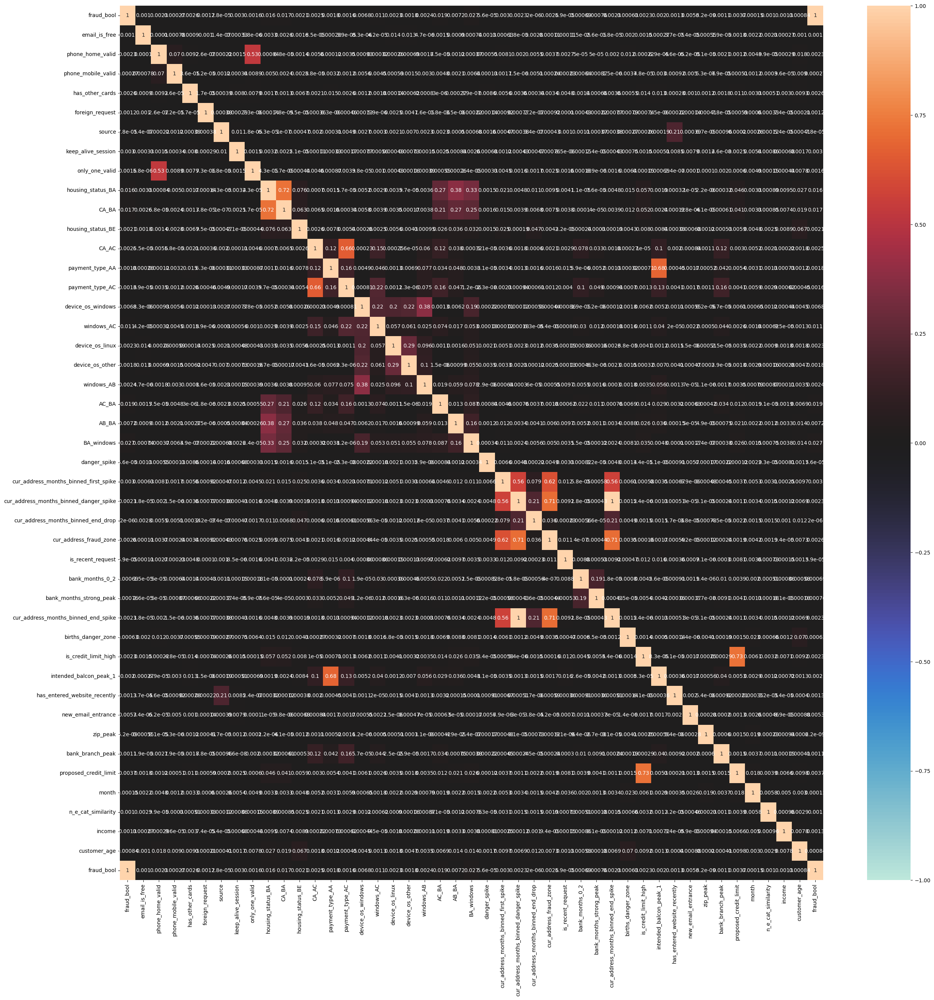

In [ ]:
plt.figure(figsize=(30, 30))
sns.heatmap(corr_matrix, vmin=-1, center=0, cmap="icefire", annot=True)

In [ ]:
importance_df[importance_df['type'] == 'cat']

,feature,type,score
8,BA_windows,cat,2.704869e-02
15,AC_BA,cat,1.932978e-02
17,CA_BA,cat,1.708641e-02
19,housing_status_BA,cat,1.591588e-02
29,windows_AC,cat,1.058966e-02
46,AB_BA,cat,7.156827e-03
47,device_os_windows,cat,6.826409e-03
49,new_email_entrance,cat,5.286120e-03
55,proposed_credit_limit,cat,3.662026e-03
58,cur_address_months_binned_first_spike,cat,3.048045e-03


Итак, картинка довольна неплохая. Большинство фич черные - значит, мало коррелируют между собой, приэтом дают информацию о fraud_bool (хоть и небольшую).
Видим, что между собой коррелируют на 1 cur_address_months_binned_end_spike и cur_address_months_binned_danger_spike. По корреляции с fraud_bool они имеют одинаковые значения (как, в прочем, и со всеми остальными), удалим cur_address_months_binned_end_spike:

In [ ]:
# corr_matrix.drop('cur_address_months_binned_end_spike', axis=0, inplace=True)
# corr_matrix.drop('cur_address_months_binned_end_spike', axis=1, inplace=True)
category_features.remove('cur_address_months_binned_end_drop')

In [ ]:
model = lgbm.LGBMClassifier(learning_rate=0.001, n_estimators=300, random_state=42)
model.fit(data[category_features], data['fraud_bool'])
category_importance_df = pd.DataFrame({'names': category_features, 'scores': model.feature_importances_})\
    .sort_values('scores', ascending=False)
category_importance_df

[LightGBM] [Info] Number of positive: 8272, number of negative: 741728
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.055053 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 118
[LightGBM] [Info] Number of data points in the train set: 750000, number of used features: 42
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.011029 -> initscore=-4.496106
[LightGBM] [Info] Start training from score -4.496106


,names,scores
40,income,1129
37,proposed_credit_limit,1041
3,has_other_cards,874
1,phone_home_valid,739
6,keep_alive_session,666
39,n_e_cat_similarity,620
11,CA_AC,572
24,cur_address_months_binned_danger_spike,479
0,email_is_free,476
34,new_email_entrance,446


In [ ]:
import shap
explainer = shap.TreeExplainer(model)
shap_values = explainer(data[category_features])

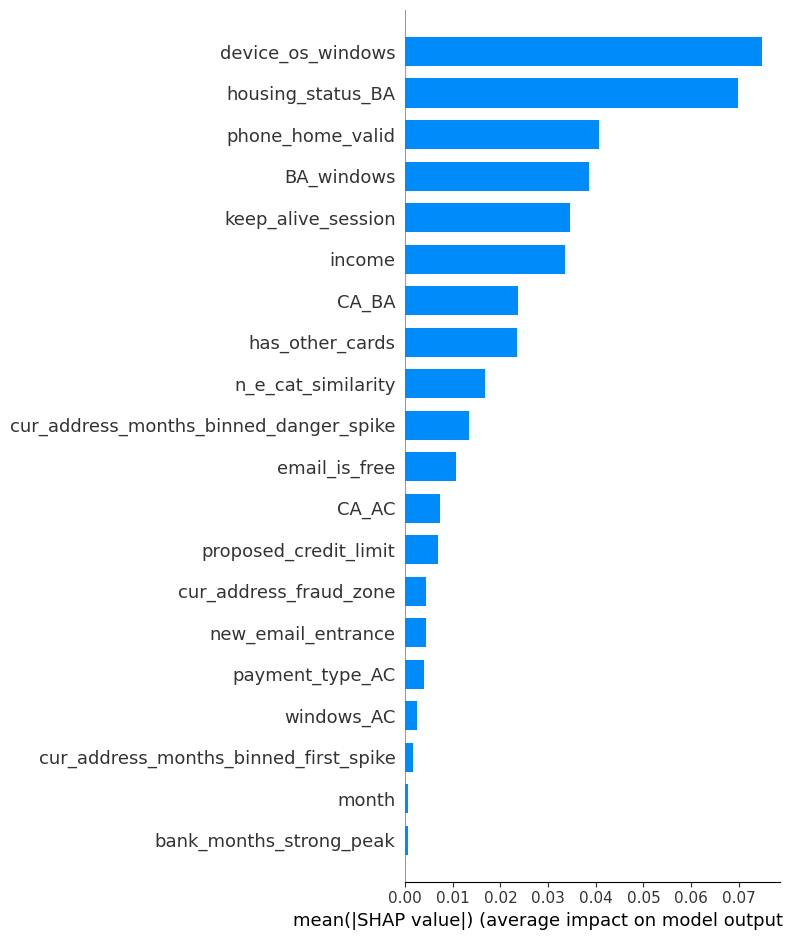

In [ ]:
plt.figure(figsize=(20, 6))
shap.summary_plot(shap_values.values, data[category_features], plot_type="bar")

In [ ]:
shap_frame = pd.DataFrame(shap_values.values, columns=category_features).mean(axis=0)\
    .sort_values(ascending=False)
shap_frame

CA_BA                                     2.541916e-03
phone_home_valid                          1.660059e-03
housing_status_BA                         9.307505e-04
device_os_windows                         6.176482e-04
has_other_cards                           4.736988e-04
email_is_free                             4.449317e-04
device_os_other                           9.230518e-05
cur_address_months_binned_danger_spike    8.825706e-06
bank_branch_peak                          4.953234e-06
foreign_request                           2.557350e-06
phone_mobile_valid                        4.736865e-07
is_recent_request                         2.653507e-07
zip_peak                                  0.000000e+00
source                                    0.000000e+00
danger_spike                              0.000000e+00
births_danger_zone                        0.000000e+00
cur_address_months_binned_end_drop        0.000000e+00
windows_AB                                0.000000e+00
AC_BA     

Так, довольно долго застрял на этом этапе. Читал статьи, вникал в суть алгоритмов и т.д.
В общем: 
1. mutual_info показывает взаимную информативность, считается довольно прямолинейно: энтропия первого списка значений плюс энтропия второго минус совместная энтропия. И тут-то и заключается прямолинейность: в совместных значениях считается пересечение множеств, т.е. условно для бинарных это кол-во соответствующих пар, в которых одновременно 0 или 1. Нормализация помогает избавиться от недостатка, что для категориальных значений с бОльшим кол-вом уникальных значений (например, month) энтропия будет больше. Но сама суть переменной по-прежнему прямая информативность.

2. feature_importances_ модели. Взяли легковесный классификатор градиентного бустинга из lgbm, подобрали параметры и все - получили рейтинг. Но все же зависит от параметров модели, для градиентной модели экспериментальный подбор learning_rate обязателен, а мы еще не подбирали гиперпараметры (подбор проведу с помощью кросс-валидации), довольно энергоемкий процесс. Вдобавок, метрики и модели еще не определены.
Но ее плюс - в отличие от mutual_info, считает важность признака в модели, т.к. в нелинейных комбинациях и комбинациях с другими фичами.

3. Shapley method - "игровая" метрика модели, т.е. считает "очки" признаков, их вклад в предсказание: может быть как отрицательным (склоняет модель к неверному предсказанию), так и положительным. В нашем случае стоит задача скорее определить мошенническую атаку, чем немошенническую, поэтому средние брали не по модулю. 

Ну и видим, что разные подходы дают разные результаты.
Решил поступить следующим образом: выбрать фичи, которые находятся в каком-то топ-k значений во всех таблицах.

In [ ]:
k = 30
mu_top = list(importance_df[importance_df['type'] == 'cat']['feature'].iloc[:k])
feature_importances_top = list(category_importance_df['names'].iloc[:k])
shap_top = list(shap_frame[:k].index)

top_features_list = [
    cat for cat in category_features
    if cat in mu_top and cat in feature_importances_top
    and cat in shap_top
]

top_features_list

['phone_home_valid',
 'has_other_cards',
 'foreign_request',
 'only_one_valid',
 'housing_status_BA',
 'CA_BA',
 'housing_status_BE',
 'payment_type_AA',
 'device_os_windows',
 'device_os_linux',
 'device_os_other',
 'cur_address_months_binned_danger_spike',
 'intended_balcon_peak_1',
 'bank_branch_peak']

Получили такой список из всего 6 фичей для топ-25, поэтому решил посмотреть на топ-30 (т.е. по факту отсеял 12 последних фич везде), и набралось уже 14 значений. А 2 самых НЕинформативных: ['only_one_valid', 'customer_age'].

Из наблюдений к данному списку еще хочется добавить income, proposed_credit_limit, BA_windows, итого - 17 фич:

In [ ]:
top_features_list = top_features_list + ['income', 'proposed_credit_limit', 'BA_windows']
len(top_features_list)

17

Метод довольно кастомный, так что на этапе моделирования воспользуемся RFE.

In [ ]:
save_list(category_features, 'cat_features_1')
save_list(top_features_list, 'top_cat_features_list')

---

Теперь переходим к непрерывных числовым признакам - посмотрим на корреляции между ними, а затем между ними и целевой величиной:

<Axes: >

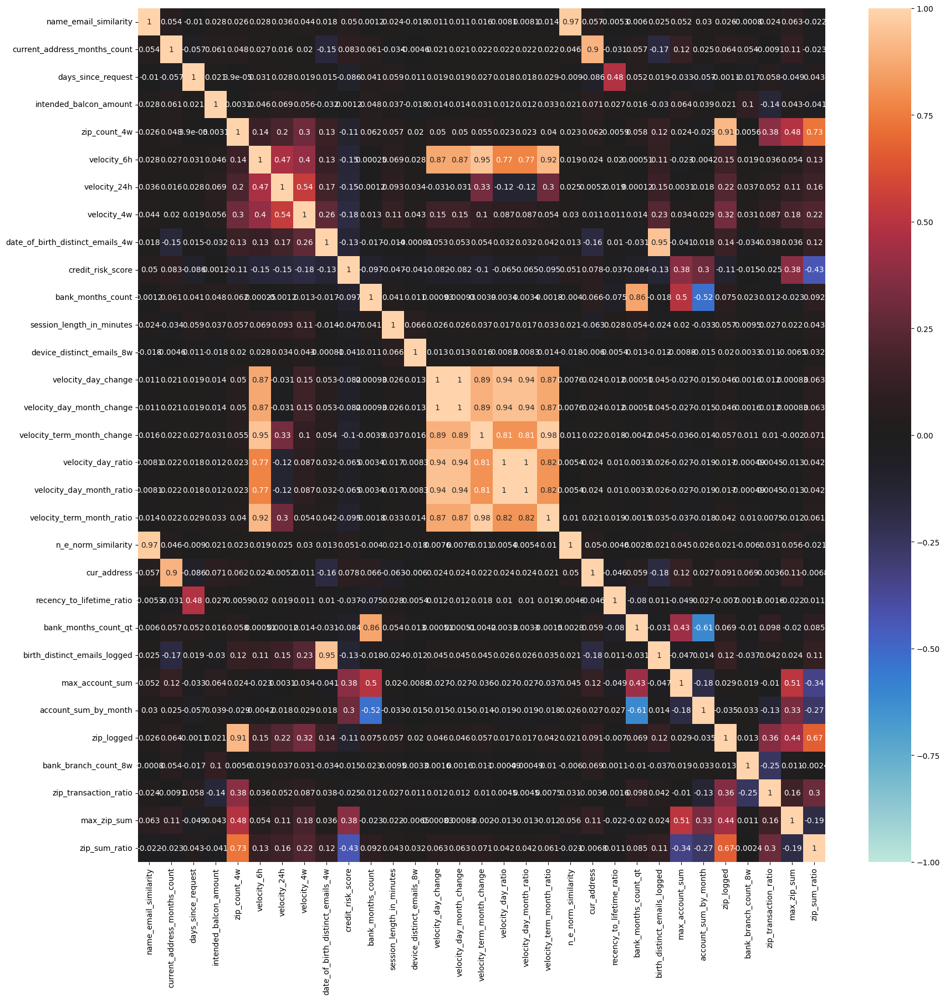

In [ ]:
plt.figure(figsize=(20, 20))
sns.heatmap(data[num_features].corr(), annot=True, cmap='icefire', vmin=-1, center=0)

In [ ]:
importance_df = open_data('data/all_features_importances_final.csv')

Здесь ситуация посложнее, много фич скоррелированы. Выведем уже посчитанные таблицы важности, а также посчитаем feature_importances_, как мы это делали выше (с теме же параметрами):

In [ ]:
importance_df[importance_df['type'] == 'continuous_pb']

,feature,type,score
0,credit_risk_score,continuous_pb,0.065018
1,max_account_sum,continuous_pb,0.059434
2,max_zip_sum,continuous_pb,0.049716
3,cur_address,continuous_pb,0.037788
4,n_e_norm_similarity,continuous_pb,0.033382
5,zip_transaction_ratio,continuous_pb,0.033382
6,name_email_similarity,continuous_pb,0.032946
7,device_distinct_emails_8w,continuous_pb,0.027452
9,birth_distinct_emails_logged,continuous_pb,0.025892
10,zip_sum_ratio,continuous_pb,0.024535


In [ ]:
importance_df[importance_df['type'] == 'continuous']

,feature,type,score
30,velocity_day_ratio,continuous,0.008931
31,velocity_day_change,continuous,0.008931
32,velocity_term_month_change,continuous,0.008931
33,velocity_day_month_change,continuous,0.008931
34,velocity_day_month_ratio,continuous,0.008931
35,velocity_term_month_ratio,continuous,0.008931
36,recency_to_lifetime_ratio,continuous,0.008930
37,velocity_24h,continuous,0.008929
38,velocity_6h,continuous,0.008928
39,name_email_similarity,continuous,0.008928


Пойдем снизу вверх.
Фичи, которые нужно удалить (они были изначально, поэтому дают высокую корреляцию) - 'name_email_similarity', 'current_address_months_count', 'date_of_birth_distinct_emails_4w', 'zip_count_4w', 'bank_months_count'.
<br><br>А так же удалим признаки, у которых показатель мультиколлинеарности выше 0.95 (выписал пары, вторые по месту дают меньшие показатели относительно fraud_bool):
'velocity_day_ratio' - 'velocity_day_month_ratio', 'velocty_term_month_change' - 'velocty_term_month_ratio',
'velocity_day_change' - 'velocity_day_month_change'

In [ ]:
data = open_data('data/bank_data_train_final_1.csv')

<Axes: >

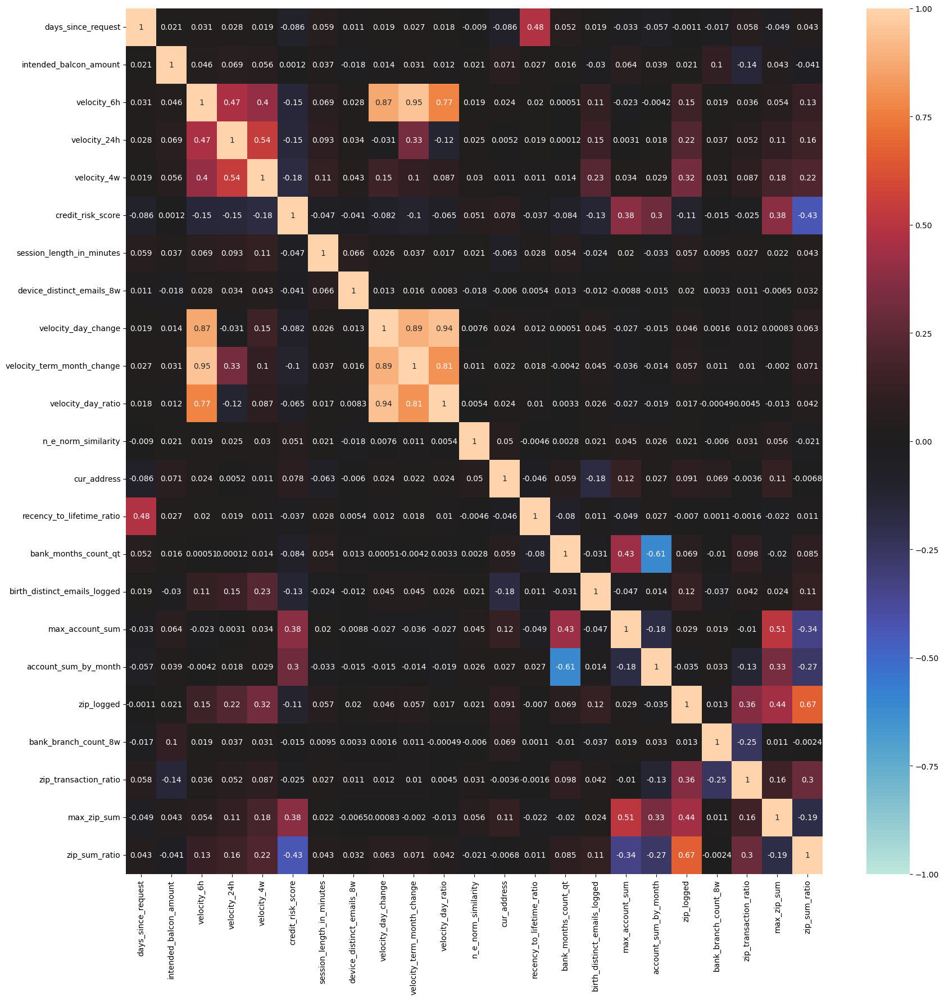

In [ ]:
num_cols_to_drop = ['name_email_similarity', 'current_address_months_count',
    'date_of_birth_distinct_emails_4w', 'zip_count_4w', 'bank_months_count', 
    'velocity_day_month_ratio', 'velocity_term_month_ratio', 'velocity_day_month_change'
]

num_features_new = [
    feature for feature in num_features 
    if feature not in num_cols_to_drop
]

# строим тепловую карту матрицы корреляций
plt.figure(figsize=(20, 20))
sns.heatmap(data[num_features_new].corr(), annot=True, cmap='icefire', vmin=-1, center=0)

In [ ]:
model = lgbm.LGBMClassifier(learning_rate=0.001, n_estimators=300, random_state=42)
model.fit(data[num_features_new], data['fraud_bool'])

num_importance_df = pd.DataFrame({'names': num_features_new, 'scores': model.feature_importances_})\
    .sort_values('scores', ascending=False)
num_importance_df

[LightGBM] [Info] Number of positive: 8272, number of negative: 741728
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.053356 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 5382
[LightGBM] [Info] Number of data points in the train set: 750000, number of used features: 23
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.011029 -> initscore=-4.496106
[LightGBM] [Info] Start training from score -4.496106


,names,scores
11,n_e_norm_similarity,1419
5,credit_risk_score,1340
7,device_distinct_emails_8w,1287
16,max_account_sum,1258
12,cur_address,954
1,intended_balcon_amount,626
17,account_sum_by_month,601
19,bank_branch_count_8w,555
14,bank_months_count_qt,325
13,recency_to_lifetime_ratio,154


Видим по-прежнему сильную корреляцию между признаками разности месяцев/дней, что сильно помешает линейной модели. Предлагаю воспользоваться техникой понижения размерности с помощью PCA, полученные фичи будем использовать в линейных моделях, а в остальных, конечно, лучше оставить исходные фичи для правальной интерпретации и во избежание потери информотивности:

In [ ]:
data = open_data('data/bank_data_train_final_1.csv')

In [ ]:
# PCA
pca_velocity = decomposition.PCA(n_components=4, svd_solver='arpack')
# список фичей, которые мы декомпозируем
vel_features = ['velocity_6h', 'velocity_24h', 'velocity_4w', 'velocity_day_change', 'velocity_term_month_change', 
                'velocity_day_ratio', 'velocity_term_month_ratio']
# трасформация фич
transformed_vel = pca_velocity.fit_transform(data[vel_features])
# добавляем новые признаки
data['vel_1'] = transformed_vel[:, 0]
data['vel_2'] = transformed_vel[:, 1]
data['vel_3'] = transformed_vel[:, 2]
data['vel_4'] = transformed_vel[:, 3]
# список новых фич
vel_new_features = ['vel_1', 'vel_2', 'vel_3', 'vel_4']
num_features_new = num_features_new + vel_new_features
# удаляем старые
# data.drop(vel_features, axis=1, inplace=True)
# num_features_new = [
#     feature for feature in num_features_new
#     if feature not in vel_features
# ]
# отображаем матрицу корреляций
plt.figure(figsize=(20, 20))
sns.heatmap(data[num_features_new].corr(), annot=True, cmap='icefire', vmin=-1, center=0)

*P.S. попробовал еще T-SNE преобразование, но результаты что по корреляциям, что по метрикам одинаковые.*

In [ ]:
# tsne = decomposition.TruncatedSVD(n_components=4)
# tsne.fit_transform(data[vel_features])

# data['vel_1t'] = transformed_vel[:, 0]
# data['vel_2t'] = transformed_vel[:, 1]
# data['vel_3t'] = transformed_vel[:, 2]
# data['vel_4t'] = transformed_vel[:, 3]
# num_features_new = num_features_new + ['vel_1t', 'vel_2t', 'vel_3t', 'vel_4t']

In [ ]:
scores = []

for col in num_features_new[-4:]:
    # считаем линейную корреляцию непрерывной фичи и целевой
    num_score, _ = stats.pointbiserialr(data['fraud_bool'], data[col])
    scores.append((col, 'continuous_pb', abs(num_score)))
    # считаем взаимную информативность - т.е. нелинейную связь
    nmi = metrics.normalized_mutual_info_score(data['fraud_bool'], data[col])
    scores.append((col, 'continuous', nmi))
    
importance_df = pd.concat([importance_df, pd.DataFrame(scores, columns=['feature', 'type', 'score'])], axis=0)

In [ ]:
importance_df_t = importance_df[~importance_df['feature'].isin(num_cols_to_drop)]
importance_df_t

,feature,type,score
0,credit_risk_score,continuous_pb,0.065018
1,max_account_sum,continuous_pb,0.059434
2,max_zip_sum,continuous_pb,0.049716
3,cur_address,continuous_pb,0.037788
4,n_e_norm_similarity,continuous_pb,0.033382
...,...,...,...
3,vel_2,continuous,0.008931
4,vel_3,continuous_pb,0.003953
5,vel_3,continuous,0.008931
6,vel_4,continuous_pb,0.005568


In [ ]:
importance_df_t[importance_df_t['type'] == 'continuous'].sort_values(by='score', ascending=False)

,feature,type,score
7,vel_4,continuous,0.008931
5,vel_3,continuous,0.008931
3,vel_2,continuous,0.008931
1,vel_1,continuous,0.008931
31,velocity_day_change,continuous,0.008931
30,velocity_day_ratio,continuous,0.008931
32,velocity_term_month_change,continuous,0.008931
36,recency_to_lifetime_ratio,continuous,0.008930
37,velocity_24h,continuous,0.008929
38,velocity_6h,continuous,0.008928


In [ ]:
importance_df_t[importance_df_t['type'] == 'continuous_pb'].sort_values(by='score', ascending=False)

,feature,type,score
0,credit_risk_score,continuous_pb,0.065018
1,max_account_sum,continuous_pb,0.059434
2,max_zip_sum,continuous_pb,0.049716
3,cur_address,continuous_pb,0.037788
4,n_e_norm_similarity,continuous_pb,0.033382
5,zip_transaction_ratio,continuous_pb,0.033382
7,device_distinct_emails_8w,continuous_pb,0.027452
9,birth_distinct_emails_logged,continuous_pb,0.025892
10,zip_sum_ratio,continuous_pb,0.024535
11,intended_balcon_amount,continuous_pb,0.023826


Ну и ожидаемо, более линейная характеристика модели показала новые фичи как одни из самых информативных, а в mutual_info просадка.
<br><br> Тогда создаем два отдельных списка для линейных и нелинейных моделей, выбираем топ-15 фич из каждой и добавляем к категориальным фичам:

In [ ]:
# топ k фич
k = 15
# создаем маски на датафрейм информативности для линейных и нелинейных показателей
linear_mask = (importance_df_t['type'] == 'continuous_pb') & (~importance_df_t['feature'].isin(vel_features))
tree_mask = (importance_df_t['type'] == 'continuous') & (~importance_df_t['feature'].isin(vel_new_features))
# отбираем топ-15 линейных и нелинейных фич
top_linear_features = list(importance_df_t[linear_mask].sort_values(by='score', ascending=False)['feature'].iloc[:k])
top_tree_features = list(importance_df_t[tree_mask].sort_values(by='score', ascending=False)['feature'].iloc[:k])
# добавляем категориальные фичи
top_linear_features = top_linear_features + top_features_list
top_tree_features = top_tree_features + top_features_list
# выводим фичи
print('Фичи для линейных моделей:', len(top_linear_features), '\n\n', top_linear_features)
print('\n-------------\n\n')
print('Фичи для нелинейных моделей:', len(top_tree_features) , '\n\n', top_tree_features)

Фичи для линейных моделей: 32 

 ['credit_risk_score', 'max_account_sum', 'max_zip_sum', 'cur_address', 'n_e_norm_similarity', 'zip_transaction_ratio', 'device_distinct_emails_8w', 'birth_distinct_emails_logged', 'zip_sum_ratio', 'intended_balcon_amount', 'bank_months_count_qt', 'vel_1', 'bank_branch_count_8w', 'vel_2', 'zip_logged', 'phone_home_valid', 'has_other_cards', 'foreign_request', 'only_one_valid', 'housing_status_BA', 'CA_BA', 'housing_status_BE', 'payment_type_AA', 'device_os_windows', 'device_os_linux', 'device_os_other', 'cur_address_months_binned_danger_spike', 'intended_balcon_peak_1', 'bank_branch_peak', 'income', 'proposed_credit_limit', 'BA_windows']

-------------


Фичи для нелинейных моделей: 32 

 ['velocity_day_ratio', 'velocity_day_change', 'velocity_term_month_change', 'recency_to_lifetime_ratio', 'velocity_24h', 'velocity_6h', 'velocity_4w', 'session_length_in_minutes', 'n_e_norm_similarity', 'intended_balcon_amount', 'days_since_request', 'device_distinct_em

In [ ]:
save_list(top_linear_features, 'top_linear_features')
save_list(top_tree_features, 'top_non_linear_features')
save_data(importance_df, 'data/all_features_importances_final.csv')
save_data(data, 'data/bank_data_final_2.csv')